# DATA MINING PROJECT

# TOPIC:
Paralized Veterans of America (PVA)



# Goals:
- Analysis of the database
- Cluster Analysis of the donors
- Marketing approaches for each cluster



# Delivery
- A Jupyter Notebook
- Report (max 15 pages)



# Definition of the steps, and sub-division of the work

- Step 1: loading the database of PVA
- Step 2: quick exploration of the database

- Step 3: Feature selection
Study of the metadata, checking for missing values (some variables have a lot of them), computing correlations between the variables in oder to reduct the dimensionality of our database.

Importing the necessary libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import spearmanr
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LassoCV
from sklearn.linear_model import RidgeCV

In [2]:
# Settting the theme for seaborn
sns.set_theme(style="ticks", palette="viridis")

Step 1: Loading the database

In [3]:
donors = pd.read_csv('donors.csv ', sep=',', index_col=0)

C:\Users\lorep\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3145: DtypeWarning: Columns (9,412) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


Data Exploration

In [4]:
donors.head()

,ODATEDW,OSOURCE,TCODE,STATE,ZIP,MAILCODE,PVASTATE,DOB,NOEXCH,RECINHSE,...,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,GEOCODE2
0,2009-01-01,GRI,0,IL,61081,,,1957-12-01,0,,...,7.741935,95515,0,L,4,E,X,X,X,C
1,2014-01-01,BOA,1,CA,91326,,,1972-02-01,0,,...,15.666667,148535,0,L,2,G,X,X,X,A
2,2010-01-01,AMH,1,NC,27017,,,NaN,0,,...,7.481481,15078,1,L,4,E,X,X,X,C
3,2007-01-01,BRY,0,CA,95953,,,1948-01-01,0,,...,6.812500,172556,1,L,4,E,X,X,X,C
4,2006-01-01,,0,FL,33176,,,1940-01-01,0,X,...,6.864865,7112,1,L,2,F,X,X,X,A


In [5]:
donors.shape

(95412, 475)

In [6]:
donors.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95412 entries, 0 to 95411
Columns: 475 entries, ODATEDW to GEOCODE2
dtypes: float64(49), int64(301), object(125)
memory usage: 346.5+ MB


In [7]:
donors.describe()

,TCODE,NUMCHLD,INCOME,WEALTH1,HIT,MBCRAFT,MBGARDEN,MBBOOKS,MBCOLECT,MAGFAML,...,NGIFTALL,CARDGIFT,MINRAMNT,MAXRAMNT,LASTGIFT,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2F
count,95412.000000,12386.000000,74126.000000,50680.000000,95412.000000,42558.000000,42558.000000,42558.000000,42498.000000,42558.000000,...,95412.000000,95412.000000,95412.000000,95412.000000,95412.000000,85439.000000,95412.000000,95412.000000,95412.000000,95412.000000
mean,54.223117,1.527773,3.886248,5.345699,3.321438,0.152075,0.059166,1.116382,0.063932,0.448329,...,9.602031,5.058242,7.933656,19.999790,17.313127,8.093739,13.347786,95778.176959,0.500618,1.910053
std,953.844476,0.806861,1.854960,2.742490,9.306899,0.470023,0.262078,1.669967,0.297344,0.821010,...,8.554342,4.526651,8.784231,25.067746,13.956630,8.213242,10.769997,55284.596094,0.500002,1.072749
min,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,5.000000,0.000000,0.000000,1.285714,1.000000,0.000000,1.000000
25%,0.000000,1.000000,2.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,3.000000,2.000000,3.000000,14.000000,10.000000,4.000000,8.384615,47910.750000,0.000000,1.000000
50%,1.000000,1.000000,4.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,7.000000,4.000000,5.000000,17.000000,15.000000,6.000000,11.636364,95681.500000,1.000000,2.000000
75%,2.000000,2.000000,5.000000,8.000000,3.000000,0.000000,0.000000,2.000000,0.000000,1.000000,...,13.000000,7.000000,10.000000,23.000000,20.000000,11.000000,15.477955,143643.500000,1.000000,3.000000
max,72002.000000,7.000000,7.000000,9.000000,241.000000,6.000000,4.000000,9.000000,6.000000,9.000000,...,237.000000,41.000000,1000.000000,5000.000000,1000.000000,1088.000000,1000.000000,191779.000000,1.000000,4.000000


In [3]:
donors.CONTROLN.unique()

array([ 95515, 148535,  15078, ..., 189641,   4693, 185114], dtype=int64)

In [6]:
len(donors.CONTROLN.unique())

95412

# Exploration of the variables:

In order
--------------------------------------------------
SECTION 1:
MAILCODE is completely useless (drop it)
MDMAUD The Major Donor Matrix Code
        very important, maybe splitting the bytes
        Already splitted in section 12!!
MAIN also important, maybe splitting the bytes too
ILD07,ILD12,ILD18 can be modified in 1 single variable

SECTION 2:
Phuc table to reduce to 1 variable

SECTION 3:
MALEMILI, MALEVET, etc. What the fuck are those variables? why percentage?
MAJOR looks important
WEALTH2 looks important due the purpose
GEOCODE maybe we also have the information with the zipcode

SECTION 4:
Is it possible to create 1? as sectioon 2
LIFESRC not in the list above, maybe not important (the way in which I have that info)

SECTION 5:
PEPSTRFL

SECTION 6:
Characteristics of the Neighborhood
100 % have to reduct this space, drop and or modify the data.
But maybe also is important if we have so much info. 
285 variables

SECTION 7:
About the promotion codes
Very important, we have 48 variables.
Considering the bytes, we have the information about the:
last mailed received, type of mail receveid, rfa situation in the moment of the received mail.

SECTION 8:
Summary variables about the date of section 7

SECTION 9:
Giving history date.
RDATE : Dates of the gift received for all the different kind of mails.
RAMNT : dollar amount of the donation for the kind of mail

SECTION 10:
Summary variables of section 9

SECTION 11:
CONTROLN index????

SECTION 12: 
Explications, variables that belong to the splitting in bytes of RFA_2 and MDMAUD

SECTION 13:
GEOCODE2

# FEATURE ANALYSIS

In [8]:
df = donors[['STATE', 
'ZIP',
'WEALTH1',
'WEALTH2',
'GEOCODE',
'GEOCODE2',
'POP901',
'POP90C4',
'ETH1',
'ETH2',
'ETH3',
'ETH4',
'ETH5',
'ETH6',
'ETH7',
'ETH8',
'ETH9',
'ETH10',
'ETH11',
'ETH12',
'ETH13',
'ETH14',
'ETH15',
'ETH16',
'AGE904',
'AGE907',
'MARR1',
'MARR2',
'MARR3',
'MARR4',
'HHP2',
'HV2',
'HV4',
'RHP4',
'MSA',
'ADI',
'DMA',
'IC5',
'TPE11',
'LFC4',
'LFC5',
'EC1',
'AFC1',
'POBC1',
'LSC1',
'LSC2',
'LSC3',
'LSC4']]

In [9]:
df

,STATE,ZIP,WEALTH1,WEALTH2,GEOCODE,GEOCODE2,POP901,POP90C4,ETH1,ETH2,...,TPE11,LFC4,LFC5,EC1,AFC1,POBC1,LSC1,LSC2,LSC3,LSC4
0,IL,61081,NaN,5.0,,C,992,47,92,1,...,16,64,44,120,0,3,88,8,0,4
1,CA,91326,9.0,9.0,02,A,3611,50,67,0,...,32,81,57,160,0,42,50,7,27,16
2,NC,27017,1.0,1.0,,C,7001,49,96,2,...,24,70,56,120,0,2,96,3,0,0
3,CA,95953,4.0,0.0,,C,640,54,61,0,...,15,68,45,120,0,29,56,41,3,0
4,FL,33176,2.0,NaN,,A,2520,46,2,98,...,27,65,49,120,1,1,99,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95407,AK,99504,NaN,NaN,,C,27380,50,78,10,...,20,83,69,136,8,4,92,3,2,4
95408,TX,77379,9.0,NaN,,A,1254,51,91,3,...,32,87,52,160,0,2,94,3,0,2
95409,MI,48910,NaN,NaN,,B,552,53,82,14,...,17,70,69,120,0,6,92,5,3,0
95410,CA,91320,NaN,7.0,04,A,1746,47,92,1,...,28,85,57,140,0,14,83,8,4,5


In [10]:
len(df.STATE.unique())

57

In [13]:
# Checking for mimssing values
df.isna().sum()

STATE           0
ZIP             0
WEALTH1     44732
WEALTH2     43823
GEOCODE         0
GEOCODE2      132
POP901          0
POP90C4         0
ETH1            0
ETH2            0
ETH3            0
ETH4            0
ETH5            0
ETH6            0
ETH7            0
ETH8            0
ETH9            0
ETH10           0
ETH11           0
ETH12           0
ETH13           0
ETH14           0
ETH15           0
ETH16           0
AGE904          0
AGE907          0
MARR1           0
MARR2           0
MARR3           0
MARR4           0
HHP2            0
HV2             0
HV4             0
RHP4            0
MSA           132
ADI           132
DMA           132
IC5             0
TPE11           0
LFC4            0
LFC5            0
EC1             0
AFC1            0
POBC1           0
LSC1            0
LSC2            0
LSC3            0
LSC4            0
dtype: int64

In [17]:
df1 = df[~df.MSA.isna()]

In [19]:
df = df1

In [21]:
df.WEALTH1.unique()

array([nan,  9.,  1.,  4.,  2.,  6.,  0.,  5.,  8.,  3.,  7.])

In [22]:
df.WEALTH2.unique()

array([ 5.,  9.,  1.,  0., nan,  3.,  2.,  6.,  8.,  4.,  7.])

In [33]:
df[df.WEALTH1 != df.WEALTH2]

,STATE,ZIP,WEALTH1,WEALTH2,GEOCODE,GEOCODE2,POP901,POP90C4,ETH1,ETH2,...,TPE11,LFC4,LFC5,EC1,AFC1,POBC1,LSC1,LSC2,LSC3,LSC4
0,IL,61081,NaN,5.0,,C,992,47,92,1,...,16,64,44,120,0,3,88,8,0,4
3,CA,95953,4.0,0.0,,C,640,54,61,0,...,15,68,45,120,0,29,56,41,3,0
4,FL,33176,2.0,NaN,,A,2520,46,2,98,...,27,65,49,120,1,1,99,0,0,0
5,AL,35603,NaN,NaN,,C,18172,49,93,6,...,23,77,50,120,0,1,97,2,0,1
6,IN,46755,6.0,3.0,,D,1067,46,99,0,...,14,61,45,120,1,0,99,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95405,CA,92581,NaN,NaN,,A,2095,50,84,1,...,25,49,27,120,0,10,84,12,0,3
95407,AK,99504,NaN,NaN,,C,27380,50,78,10,...,20,83,69,136,8,4,92,3,2,4
95408,TX,77379,9.0,NaN,,A,1254,51,91,3,...,32,87,52,160,0,2,94,3,0,2
95409,MI,48910,NaN,NaN,,B,552,53,82,14,...,17,70,69,120,0,6,92,5,3,0


In [34]:
df[df.WEALTH1 == df.WEALTH2]

,STATE,ZIP,WEALTH1,WEALTH2,GEOCODE,GEOCODE2,POP901,POP90C4,ETH1,ETH2,...,TPE11,LFC4,LFC5,EC1,AFC1,POBC1,LSC1,LSC2,LSC3,LSC4
1,CA,91326,9.0,9.0,02,A,3611,50,67,0,...,32,81,57,160,0,42,50,7,27,16
2,NC,27017,1.0,1.0,,C,7001,49,96,2,...,24,70,56,120,0,2,96,3,0,0
8,IA,51033,2.0,2.0,,D,2268,49,99,0,...,19,70,44,120,0,0,98,1,0,1
14,UT,84720,6.0,6.0,,D,880,51,98,0,...,12,69,45,154,0,0,96,1,2,1
25,CA,93527-,8.0,8.0,04,B,3142,50,95,1,...,24,68,54,124,0,3,94,4,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95394,FL,32776,5.0,5.0,,C,1725,49,97,1,...,40,74,58,120,0,5,92,3,0,5
95396,CA,94305,9.0,9.0,01,A,2515,56,86,2,...,14,60,59,164,0,16,82,3,3,12
95400,FL,33157,9.0,9.0,,A,5296,45,92,5,...,30,70,46,136,1,10,85,11,1,4
95406,FL,32776-,6.0,6.0,,C,1834,49,88,8,...,30,75,50,120,0,5,95,2,0,3


In [27]:
df[df.WEALTH1.isna() & df.WEALTH2.isna()]

,STATE,ZIP,WEALTH1,WEALTH2,GEOCODE,GEOCODE2,POP901,POP90C4,ETH1,ETH2,...,TPE11,LFC4,LFC5,EC1,AFC1,POBC1,LSC1,LSC2,LSC3,LSC4
5,AL,35603,NaN,NaN,,C,18172,49,93,6,...,23,77,50,120,0,1,97,2,0,1
17,IL,62376,NaN,NaN,,C,4429,49,99,0,...,26,70,54,120,0,0,98,1,0,1
19,NC,27850,NaN,NaN,,C,5915,47,46,51,...,24,59,43,120,0,0,98,1,0,1
22,FL,33983,NaN,NaN,,C,1818,49,91,7,...,24,62,58,120,0,7,89,2,0,9
26,IL,60091,NaN,NaN,,A,1666,49,90,0,...,32,83,53,160,0,19,77,1,11,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95397,CO,80003,NaN,NaN,,B,2120,45,84,1,...,24,88,69,133,0,6,93,2,4,1
95402,AL,35653,NaN,NaN,,D,938,49,96,2,...,22,71,53,120,0,1,96,1,3,0
95405,CA,92581,NaN,NaN,,A,2095,50,84,1,...,25,49,27,120,0,10,84,12,0,3
95407,AK,99504,NaN,NaN,,C,27380,50,78,10,...,20,83,69,136,8,4,92,3,2,4


In [28]:
df[df.WEALTH1.isna() & df.WEALTH2.notna()]

,STATE,ZIP,WEALTH1,WEALTH2,GEOCODE,GEOCODE2,POP901,POP90C4,ETH1,ETH2,...,TPE11,LFC4,LFC5,EC1,AFC1,POBC1,LSC1,LSC2,LSC3,LSC4
0,IL,61081,NaN,5.0,,C,992,47,92,1,...,16,64,44,120,0,3,88,8,0,4
9,TN,37127-,NaN,9.0,03,B,2607,49,57,26,...,23,68,60,120,0,14,84,0,15,0
13,LA,70791,NaN,6.0,,B,17649,49,68,31,...,27,68,46,120,0,0,97,0,0,2
23,IL,60042,NaN,2.0,,A,1990,50,98,0,...,35,81,72,120,0,3,93,3,0,3
38,MN,55112,NaN,6.0,,A,1771,48,96,0,...,24,85,72,138,0,2,95,1,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95398,WI,53223,NaN,9.0,,B,2368,50,85,12,...,22,78,69,140,0,5,92,1,3,4
95399,GA,30736,NaN,1.0,,B,1038,49,99,0,...,22,65,47,120,0,0,99,1,0,0
95403,MN,55932,NaN,5.0,,D,1663,50,99,0,...,23,75,62,120,0,0,97,1,0,2
95404,KY,41701-,NaN,3.0,,D,10214,49,98,2,...,23,49,30,118,0,0,99,0,0,0


In [29]:
df[df.WEALTH1.notna() & df.WEALTH2.isna()]

,STATE,ZIP,WEALTH1,WEALTH2,GEOCODE,GEOCODE2,POP901,POP90C4,ETH1,ETH2,...,TPE11,LFC4,LFC5,EC1,AFC1,POBC1,LSC1,LSC2,LSC3,LSC4
4,FL,33176,2.0,NaN,,A,2520,46,2,98,...,27,65,49,120,1,1,99,0,0,0
7,LA,70611,9.0,NaN,,C,1485,51,96,2,...,23,85,65,120,0,0,95,1,0,4
10,KS,67335,0.0,NaN,,D,3356,47,98,0,...,22,66,48,120,0,0,98,1,0,1
11,IN,46220,5.0,NaN,,B,448,43,99,0,...,21,89,71,148,0,6,94,1,0,4
15,CA,90056,9.0,NaN,05,A,2539,47,34,59,...,25,72,56,160,0,7,86,9,1,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95384,TX,78418,9.0,NaN,,B,630,53,98,0,...,26,65,47,148,5,3,95,0,1,3
95387,GA,31904,3.0,NaN,,B,884,42,97,2,...,16,64,51,120,0,1,99,1,0,0
95389,NM,87031,5.0,NaN,,D,1824,50,77,2,...,42,62,42,120,1,7,74,25,0,1
95401,LA,70806,8.0,NaN,,B,1523,44,97,3,...,19,68,58,143,0,1,92,3,0,5


In [31]:
df[df.WEALTH1.notna() & df.WEALTH2.notna()]

,STATE,ZIP,WEALTH1,WEALTH2,GEOCODE,GEOCODE2,POP901,POP90C4,ETH1,ETH2,...,TPE11,LFC4,LFC5,EC1,AFC1,POBC1,LSC1,LSC2,LSC3,LSC4
1,CA,91326,9.0,9.0,02,A,3611,50,67,0,...,32,81,57,160,0,42,50,7,27,16
2,NC,27017,1.0,1.0,,C,7001,49,96,2,...,24,70,56,120,0,2,96,3,0,0
3,CA,95953,4.0,0.0,,C,640,54,61,0,...,15,68,45,120,0,29,56,41,3,0
6,IN,46755,6.0,3.0,,D,1067,46,99,0,...,14,61,45,120,1,0,99,0,1,1
8,IA,51033,2.0,2.0,,D,2268,49,99,0,...,19,70,44,120,0,0,98,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95394,FL,32776,5.0,5.0,,C,1725,49,97,1,...,40,74,58,120,0,5,92,3,0,5
95396,CA,94305,9.0,9.0,01,A,2515,56,86,2,...,14,60,59,164,0,16,82,3,3,12
95400,FL,33157,9.0,9.0,,A,5296,45,92,5,...,30,70,46,136,1,10,85,11,1,4
95406,FL,32776-,6.0,6.0,,C,1834,49,88,8,...,30,75,50,120,0,5,95,2,0,3


In [48]:
df.WEALTH2 = df.WEALTH2.fillna(value=df.WEALTH1)

C:\Users\lorep\anaconda3\lib\site-packages\pandas\core\generic.py:5168: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [49]:
df

,STATE,ZIP,WEALTH1,WEALTH2,GEOCODE,GEOCODE2,POP901,POP90C4,ETH1,ETH2,...,TPE11,LFC4,LFC5,EC1,AFC1,POBC1,LSC1,LSC2,LSC3,LSC4
0,IL,61081,NaN,5.0,,C,992,47,92,1,...,16,64,44,120,0,3,88,8,0,4
1,CA,91326,9.0,9.0,02,A,3611,50,67,0,...,32,81,57,160,0,42,50,7,27,16
2,NC,27017,1.0,1.0,,C,7001,49,96,2,...,24,70,56,120,0,2,96,3,0,0
3,CA,95953,4.0,0.0,,C,640,54,61,0,...,15,68,45,120,0,29,56,41,3,0
4,FL,33176,2.0,2.0,,A,2520,46,2,98,...,27,65,49,120,1,1,99,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95407,AK,99504,NaN,NaN,,C,27380,50,78,10,...,20,83,69,136,8,4,92,3,2,4
95408,TX,77379,9.0,9.0,,A,1254,51,91,3,...,32,87,52,160,0,2,94,3,0,2
95409,MI,48910,NaN,NaN,,B,552,53,82,14,...,17,70,69,120,0,6,92,5,3,0
95410,CA,91320,NaN,7.0,04,A,1746,47,92,1,...,28,85,57,140,0,14,83,8,4,5


In [50]:
# Checking for mimssing values
df.isna().sum()

STATE           0
ZIP             0
WEALTH1     44632
WEALTH2     21799
GEOCODE         0
GEOCODE2        0
POP901          0
POP90C4         0
ETH1            0
ETH2            0
ETH3            0
ETH4            0
ETH5            0
ETH6            0
ETH7            0
ETH8            0
ETH9            0
ETH10           0
ETH11           0
ETH12           0
ETH13           0
ETH14           0
ETH15           0
ETH16           0
AGE904          0
AGE907          0
MARR1           0
MARR2           0
MARR3           0
MARR4           0
HHP2            0
HV2             0
HV4             0
RHP4            0
MSA             0
ADI             0
DMA             0
IC5             0
TPE11           0
LFC4            0
LFC5            0
EC1             0
AFC1            0
POBC1           0
LSC1            0
LSC2            0
LSC3            0
LSC4            0
dtype: int64

In [53]:
del df['WEALTH1']

States in variable STATE
We have the 50 states of america + 
DC : the District of Columbia (washington)
AA, AE, AP that are military states of America

In [87]:
len(df.ZIP.unique())

19867

In [91]:
df.ZIP.unique()

array(['61081', '91326', '27017', ..., '55932', '92581', '32776-'],
      dtype=object)

In [93]:
df.ZIP.isna().sum()

0

In [97]:
df.ZIP.dtype

dtype('O')

In [98]:
df.GEOCODE.unique()

array([' ', '02', '03', '05', '04', '14', '01', '12'], dtype=object)

In [99]:
df.GEOCODE2.unique()

array(['C', 'A', 'D', 'B', ' '], dtype=object)

# Exploration of Neighborhood variables 
Variables from 72 to 357 of donors dataset

In [6]:
# slicing the variables
df = donors.iloc[:, 72:358]

In [5]:
# view of the dataset
df

,POP901,POP902,POP903,POP90C1,POP90C2,POP90C3,POP90C4,POP90C5,ETH1,ETH2,...,HC16,HC17,HC18,HC19,HC20,HC21,MHUC1,MHUC2,AC1,AC2
0,992,264,332,0,35,65,47,53,92,1,...,0,33,65,40,99,99,6,2,10,7
1,3611,940,998,99,0,0,50,50,67,0,...,0,99,0,99,99,99,20,4,6,5
2,7001,2040,2669,0,2,98,49,51,96,2,...,15,22,77,17,97,92,9,2,6,5
3,640,160,219,0,8,92,54,46,61,0,...,16,23,77,22,93,89,16,2,6,6
4,2520,627,761,99,0,0,46,54,2,98,...,0,99,1,21,99,96,6,2,7,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95407,27380,7252,10037,99,0,0,50,50,78,10,...,1,93,7,98,99,98,16,4,4,3
95408,1254,322,361,96,0,4,51,49,91,3,...,0,69,31,67,99,97,18,5,3,2
95409,552,131,205,99,0,0,53,47,82,14,...,4,99,0,99,99,99,5,2,3,11
95410,1746,432,508,99,0,0,47,53,92,1,...,0,99,0,99,99,99,12,3,6,3


In [7]:
# Checking for missing values in all the dataset

# we do not have missing values at all for those variables
np.sum(df.isna().sum())

396

In [8]:
any(df.isnull())

True

In [9]:
# Which columns contain Nan values?
nan_values = df.isna()
nan_columns = nan_values.any()
columns_with_nan = df.columns[nan_columns].tolist()
print(columns_with_nan)

['MSA', 'ADI', 'DMA']


In [10]:
# Checking for number of rows with 0 person in the neighborhood
print('We have',len(df[df.POP901==0] ),'donors with 0 person in their neighborhood')

# Dropping the columns with 0 person in the neighborhood
df = df[df.POP901!=0]

We have 799 donors with 0 person in their neighborhood


In [11]:
# Still missing values?
any(df.isna())

True

In [12]:
# Which columns contain Nan values?
nan_values = df.isna()
nan_columns = nan_values.any()
columns_with_nan = df.columns[nan_columns].tolist()
print(columns_with_nan)

[]


In [13]:
# Checking for nan values
np.sum(df.isna().sum())

0

In [21]:
# Checking again for nan values for those variables
df.iloc[:, 120:123].isna().sum()

MSA    0
ADI    0
DMA    0
dtype: int64

In [14]:
# Checking the minimum value for all the dataset

### AFTER DROPPING VARIABLES WITH 0 PERSON IN THE NEIGHBORHOOD

# Which variable doesn't have min value == 0?
t = df.min() != 0
[i for i, x in enumerate(t) if x]

[0, 24, 25, 26, 27, 28, 29, 107, 214]

In [15]:
# THESE ARE THE ONLY VARIABLES WITH NOT MIN = 0 afte dropping the values with 0 person in the neighborhood
df.iloc[:, [0, 24, 25, 26, 27, 28, 29, 107, 214]]

,POP901,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,RHP3,EC1
0,992,39,48,51,40,50,54,15,120
1,3611,34,41,43,32,42,45,21,160
2,7001,35,43,46,37,45,49,14,120
3,640,32,40,44,34,43,47,15,120
4,2520,33,45,50,36,46,50,16,120
...,...,...,...,...,...,...,...,...,...
95407,27380,28,35,38,29,38,41,15,136
95408,1254,30,40,40,28,41,43,20,160
95409,552,28,35,37,30,41,44,14,120
95410,1746,34,42,45,36,45,49,18,140


# CREATING USEFUL FUNCTIONS

In [91]:
def statistical_summary(data):
    print('Max percentage \n', data.max())
    print('--------------------------------------------------------------')
    print('Median percentage \n', data.median())
    print('--------------------------------------------------------------')
    print('Min percentage \n', data.min())

In [92]:
def correlation_matrix(data):
    # Prepare figure
    fig = plt.figure(figsize=(10, 8))
    # Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
    corr = np.round(data.corr(method="pearson"), decimals=2)

    # Build annotation matrix (values above |0.5| will appear annotated in the plot)
    mask_annot = np.absolute(corr.values) >= 0.5
    annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

    # Plot heatmap of the correlation matrix
    sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

    # Layout
    fig.subplots_adjust(top=0.95)
    fig.suptitle("Correlation Matrix", fontsize=20)

    plt.show()

In [98]:
def pairplot(data):
    sns.pairplot(data)
    plt.show()

In [94]:
def histogram(data):
    for i in data.columns:
        sns.displot(df, x=i, kind="kde")
        plt.show()

In [95]:
def boxplot(data):  
    for i in data.columns:
        sns.boxplot(data=df, x=i)
        plt.show()

In [96]:
def overview(data):
    return statistical_summary(data), correlation_matrix(data)

POP901                      Number of Persons
POP902                      Number of Families
POP903                      Number of Households

In [64]:
data=df.iloc[:,0:3]

Max percentage 
 POP901    98701
POP902    23766
POP903    35403
dtype: int64
--------------------------------------------------------------
Median percentage 
 POP901    1579.0
POP902     425.0
POP903     589.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 POP901    1
POP902    0
POP903    0
dtype: int64


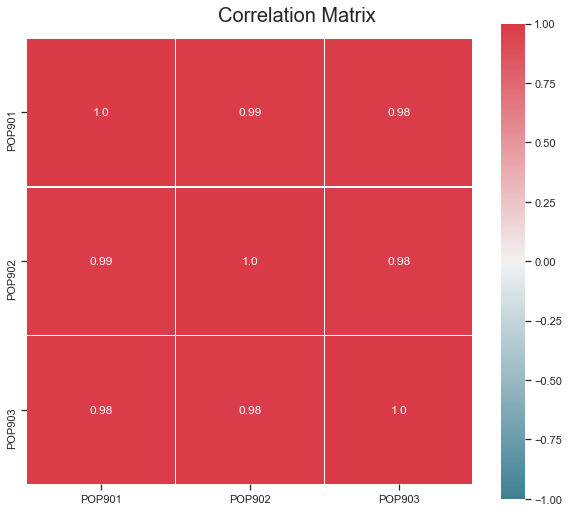

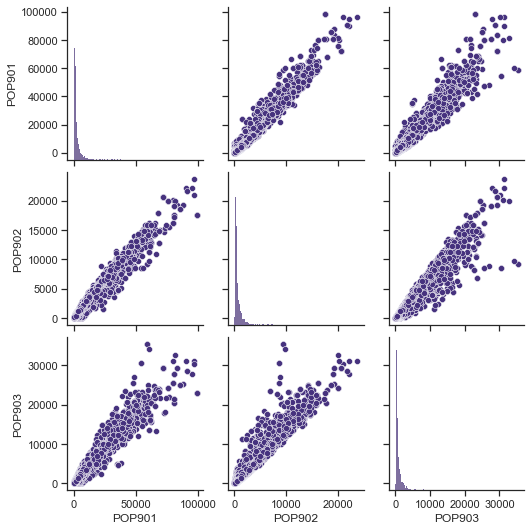

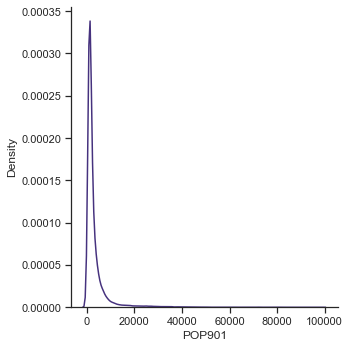

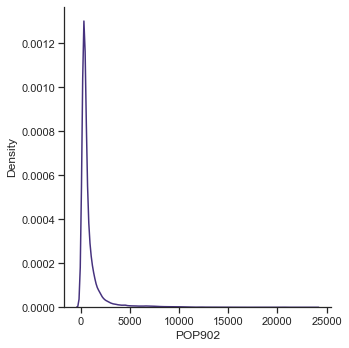

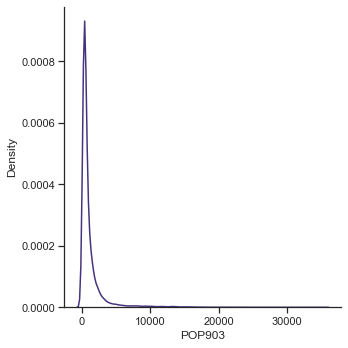

(None, None, None, None)

In [70]:
overview(data)

In [54]:
# Checking for number of rows with 0 person in the neighborhood
print('We have',len(df[df.POP901==0] ),'donors with 0 person in their neighborhood')

# Dropping the columns with 0 person in the neighborhood
df = df[df.POP901!=0]

We have 799 donors with 0 person in their neighborhood


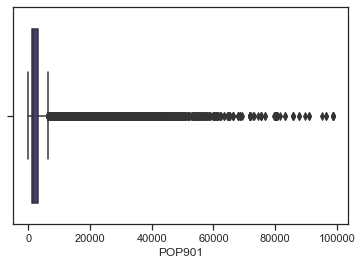

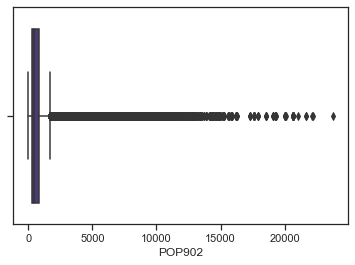

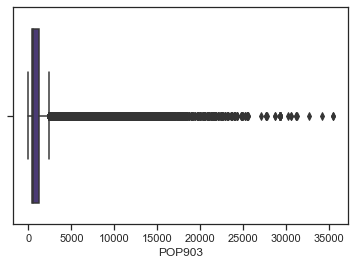

In [78]:
boxplot(data)

POP90C1                     Percent Population in Urbanized Area
POP90C2                     Percent Population Outside Urbanized Area
POP90C3                     Percent Population Inside Rural Area
POP90C4                     Percent Male
POP90C5                     Percent Female
ETH1                        Percent White
ETH2                        Percent Black
ETH3                        Percent Native American
ETH4                        Percent Pacific Islander/Asian
ETH5                        Percent Hispanic
ETH6                        Percent Asian Indian
ETH7                        Percent Japanese
ETH8                        Percent Chinese
ETH9                        Percent Philipino
ETH10                       Percent Korean
ETH11                       Percent Vietnamese
ETH12                       Percent Hawaiian
ETH13                       Percent Mexican
ETH14                       Percent Puerto Rican
ETH15                       Percent Cuban
ETH16                       Percent Other Hispanic

Max percentage 
 POP90C1    99
POP90C2    99
POP90C3    99
POP90C4    99
POP90C5    99
ETH1       99
ETH2       99
ETH3       99
ETH4       99
ETH5       99
ETH6       22
ETH7       72
ETH8       99
ETH9       67
ETH10      46
ETH11      47
ETH12      72
ETH13      97
ETH14      57
ETH15      81
ETH16      86
dtype: int64
--------------------------------------------------------------
Median percentage 
 POP90C1    99.0
POP90C2     0.0
POP90C3     0.0
POP90C4    49.0
POP90C5    51.0
ETH1       93.0
ETH2        1.0
ETH3        0.0
ETH4        1.0
ETH5        2.0
ETH6        0.0
ETH7        0.0
ETH8        0.0
ETH9        0.0
ETH10       0.0
ETH11       0.0
ETH12       0.0
ETH13       1.0
ETH14       0.0
ETH15       0.0
ETH16       1.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 POP90C1    0
POP90C2    0
POP90C3    0
POP90C4    0
POP90C5    0
ETH1       0
ETH2       0
ETH3       0
ETH4       0
ETH5       0
ETH6       0
ETH7       0
ETH8  

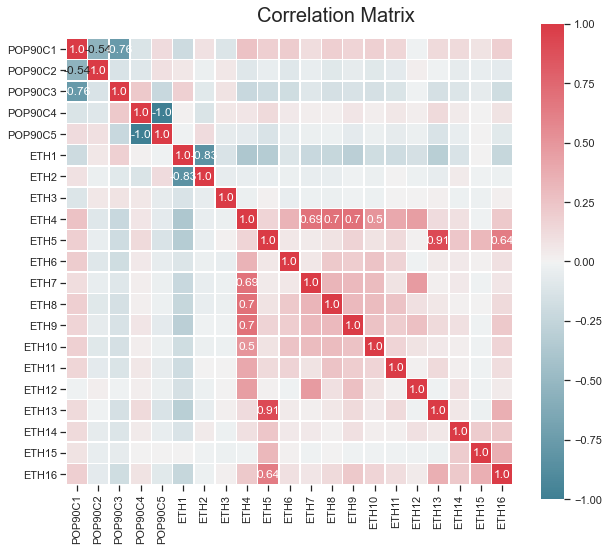

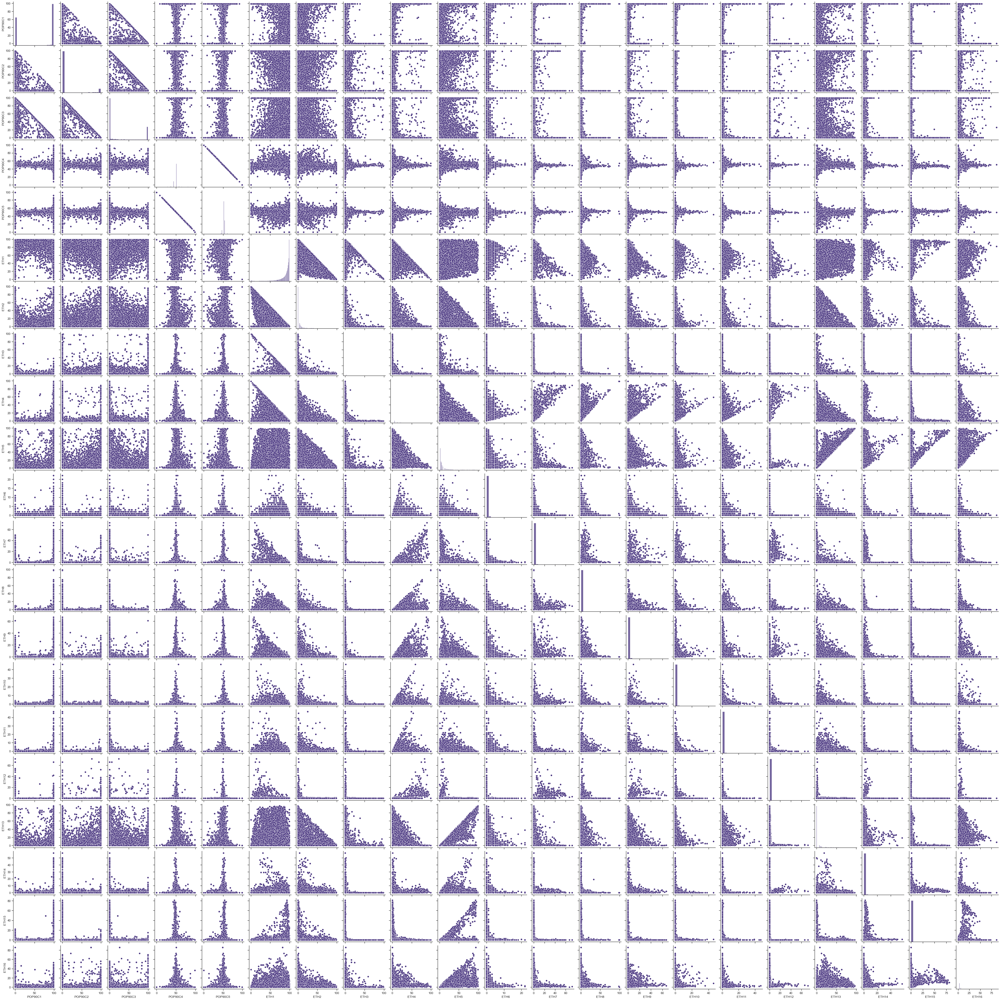

(None, None, None)

In [82]:
overview(data)

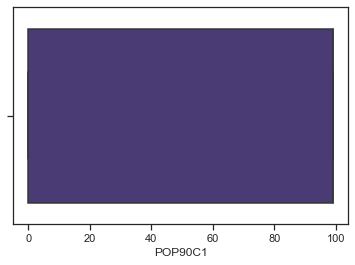

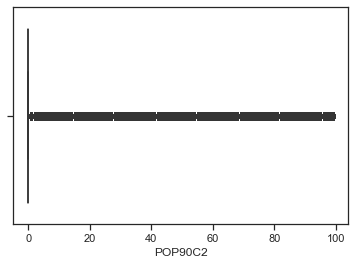

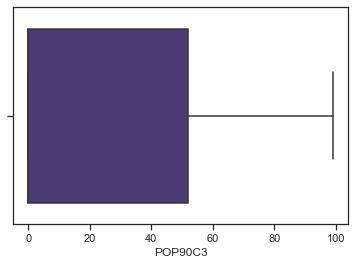

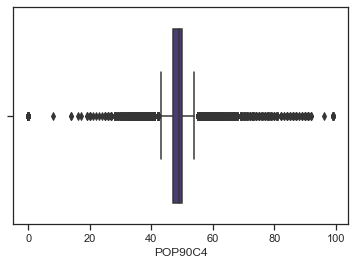

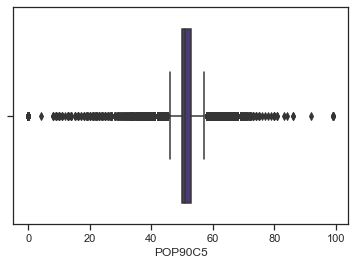

...

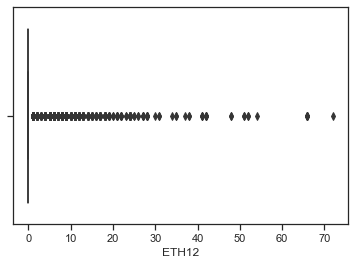

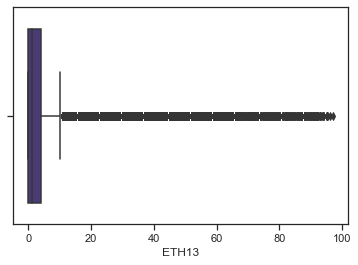

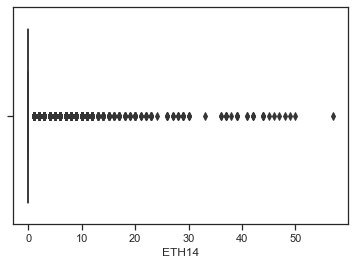

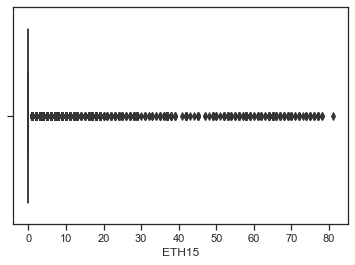

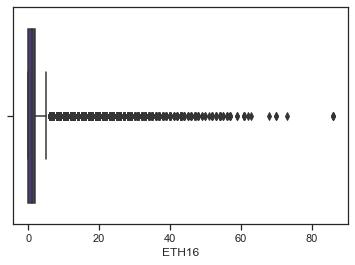

In [16]:
# Plotting the distribution
for i in df.iloc[:, 3:24].columns:
    sns.boxplot(data=df, x=i)
    plt.show()

AGE901                      Median Age of Population
AGE902                      Median Age of Adults 18 or Older
AGE903                      Median Age of Adults 25 or Older
AGE904                      Average Age of Population
AGE905                      Average Age of Adults >= 18
AGE906                      Average Age of Adults >= 25

Max percentage 
 AGE901    84
AGE902    84
AGE903    84
AGE904    84
AGE905    84
AGE906    84
dtype: int64
--------------------------------------------------------------
Median percentage 
 AGE901    33.0
AGE902    41.0
AGE903    44.0
AGE904    35.0
AGE905    45.0
AGE906    48.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 AGE901     8
AGE902    19
AGE903    27
AGE904    12
AGE905    19
AGE906    27
dtype: int64


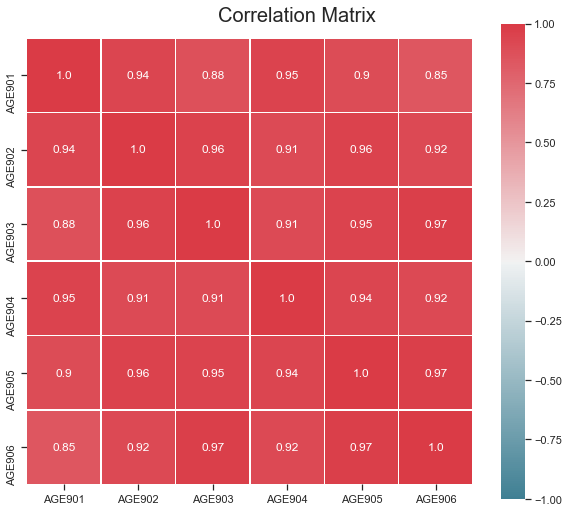

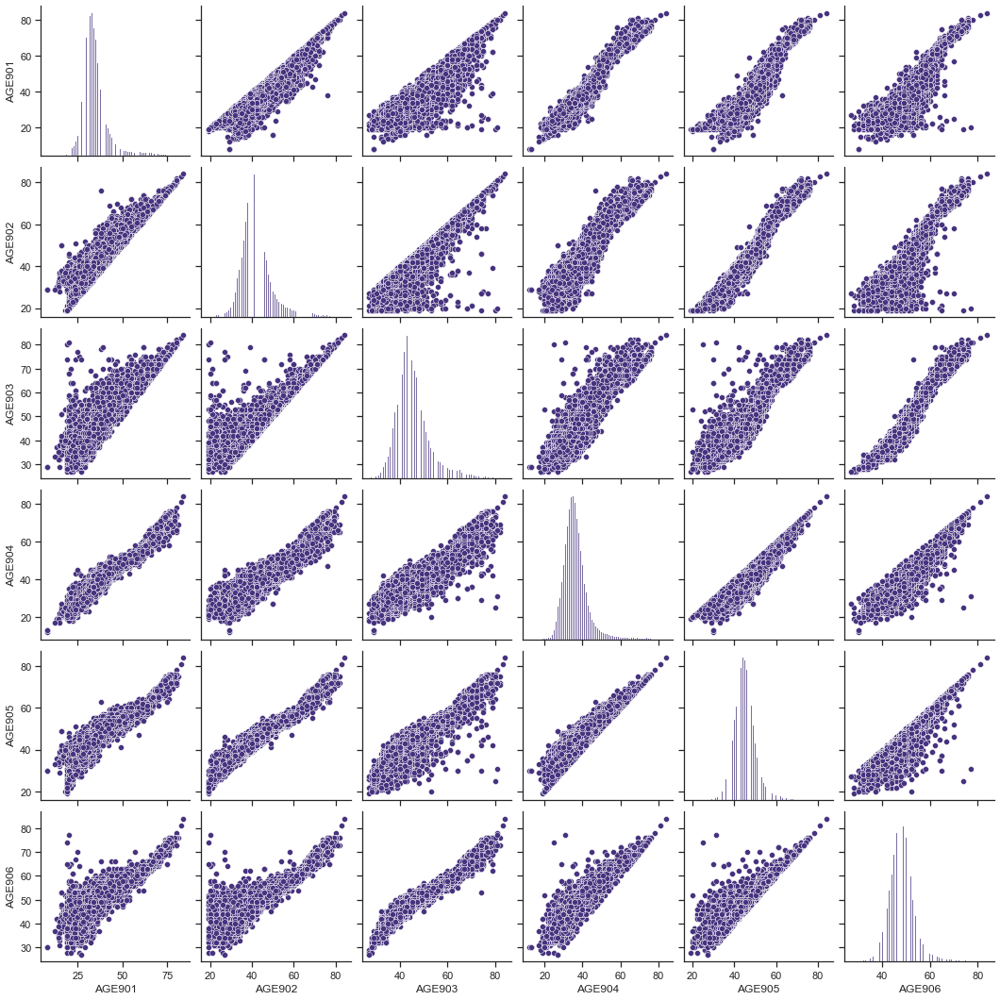

(None, None, None)

In [83]:
data = df.iloc[:, 24:30]
overview(data)

AGE907                      Percent Population Under Age 18
CHIL1                       Percent Children Under Age 7
CHIL2                       Percent Children Age 7 - 13
CHIL3                       Percent Children Age 14-17
AGEC1                       Percent Adults Age18-24
AGEC2                       Percent Adults Age 25-34
AGEC3                       Percent Adults Age 35-44
AGEC4                       Percent Adults Age 45-54
AGEC5                       Percent Adults Age 55-64
AGEC6                       Percent Adults Age 65-74
AGEC7                       Percent Adults Age >= 75
CHILC1                      Percent Children Age <=2
CHILC2                      Percent Children Age 3-5
CHILC3                      Percent Children Age 6-11
CHILC4                      Percent Children Age 12-15
CHILC5                      Percent Children Age 16-18
HHAGE1                      Percent Households w/ Person 65+
HHAGE2                      Percent Households w/ Person 65+ Living Alone
HHAGE3                      Percent Households Headed by an Elderly Person Age 65+
HHN1                        Percent 1 Person Households
HHN2                        Percent 2 Person Households
HHN3                        Percent 3 or More Person Households
HHN4                        Percent 4 or More Person Households
HHN5                        Percent 5 or More Person Households
HHN6                        Percent 6 Person Households
MARR1                       Percent Married
MARR2                       Percent Separated or Divorced
MARR3                       Percent Widowed
MARR4                       Percent Never Married

In [33]:
# Missing values and statistics
print('Max value \n', df.iloc[:, 30:59].max())

print('--------------------------------------------------------------')

print('Median \n' ,df.iloc[:, 30:59].median())

print('--------------------------------------------------------------')

print('Min value \n', df.iloc[:, 30:59].min())

Max value 
 AGE907    75
CHIL1     99
CHIL2     99
CHIL3     99
AGEC1     99
AGEC2     99
AGEC3     99
AGEC4     99
AGEC5     99
AGEC6     99
AGEC7     99
CHILC1    99
CHILC2    99
CHILC3    99
CHILC4    99
CHILC5    99
HHAGE1    99
HHAGE2    99
HHAGE3    99
HHN1      99
HHN2      99
HHN3      99
HHN4      99
HHN5      99
HHN6      99
MARR1     99
MARR2     99
MARR3     73
MARR4     99
dtype: int64
--------------------------------------------------------------
Median 
 AGE907    26.0
CHIL1     39.0
CHIL2     39.0
CHIL3     21.0
AGEC1     12.0
AGEC2     22.0
AGEC3     20.0
AGEC4     14.0
AGEC5     12.0
AGEC6     10.0
AGEC7      6.0
CHILC1    16.0
CHILC2    16.0
CHILC3    32.0
CHILC4    20.0
CHILC5    15.0
HHAGE1    23.0
HHAGE2     8.0
HHAGE3    21.0
HHN1      21.0
HHN2      33.0
HHN3      44.0
HHN4      26.0
HHN5      10.0
HHN6       3.0
MARR1     61.0
MARR2     10.0
MARR3      7.0
MARR4     21.0
dtype: float64
--------------------------------------------------------------
Min value 
 A

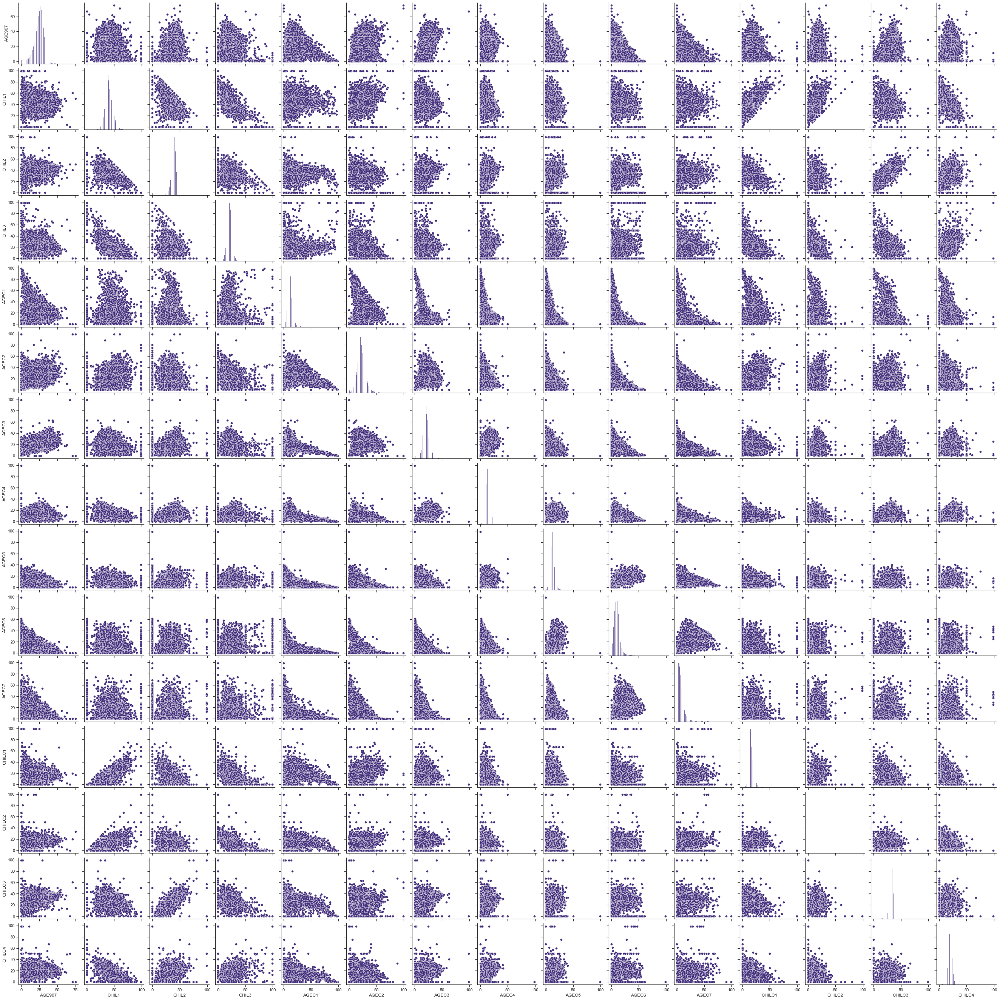

In [23]:
sns.pairplot(df.iloc[:, 30:45])
plt.show()

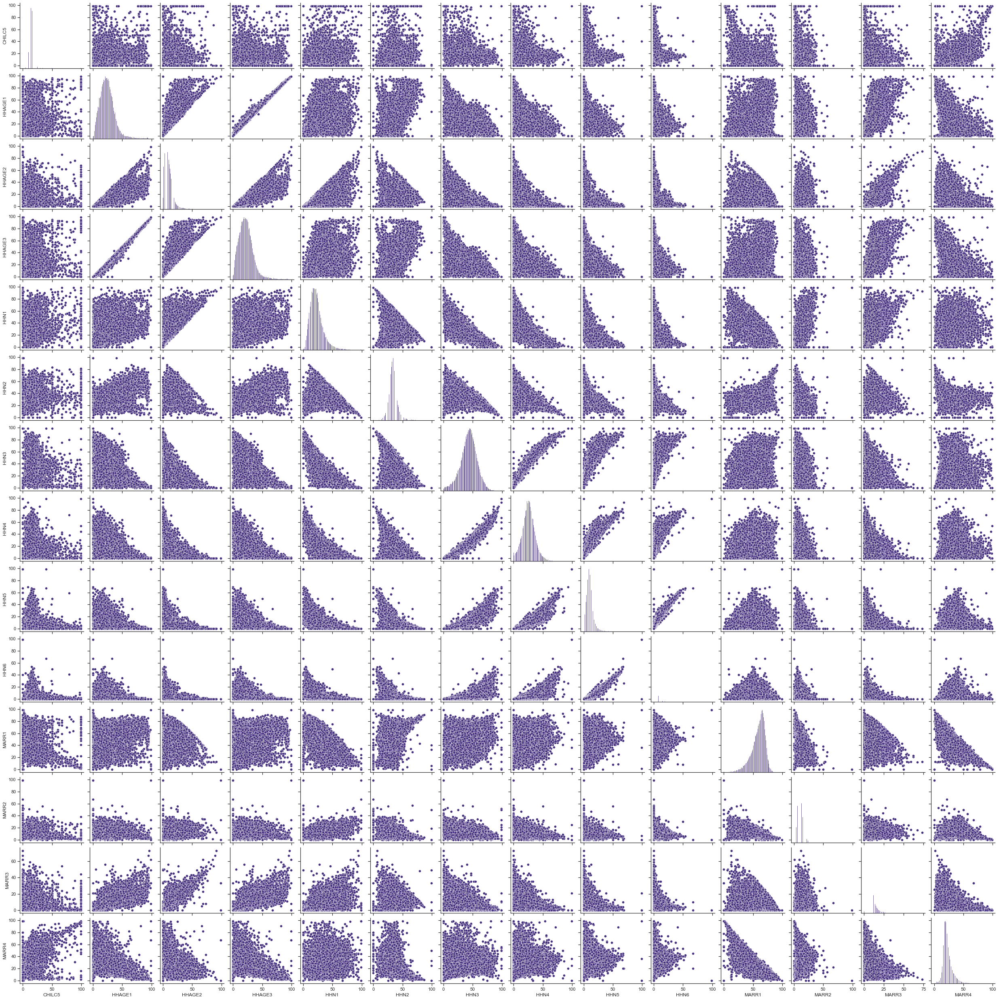

In [32]:
sns.pairplot(df.iloc[:, 45:59])
plt.show()

HHP1                        Median Person Per Household
HHP2                        Average Person Per Household

Max percentage 
 HHP1    650
HHP2    700
dtype: int64
--------------------------------------------------------------
Median percentage 
 HHP1    182.0
HHP2    263.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 HHP1    0
HHP2    0
dtype: int64


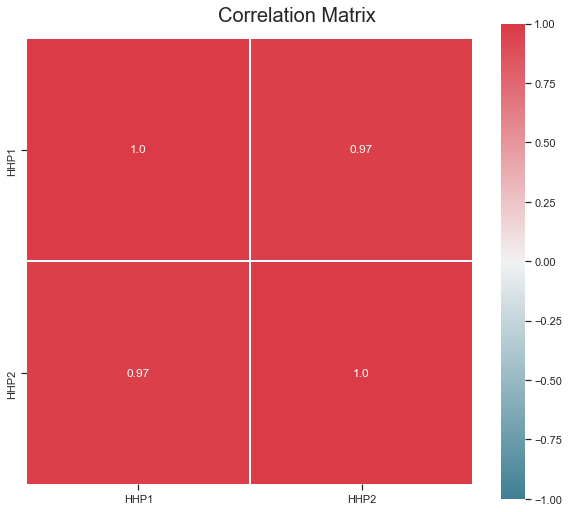

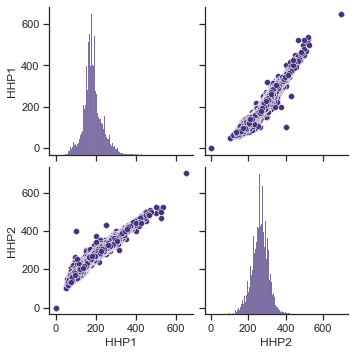

In [39]:
data=df.iloc[:, 59:61]
overview(data)
pairplot(data)

In [ ]:
DW1                         Percent Single Unit Structure
DW2                         Percent Detached Single Unit Structure
DW3                         Percent Duplex Structure
DW4                         Percent Multi (2+) Unit Structures
DW5                         Percent 3+ Unit Structures
DW6                         Percent Housing Units in 5+ Unit Structure
DW7                         Percent Group Quarters
DW8                         Percent Institutional Group Quarters

Max percentage 
 DW1    99
DW2    99
DW3    99
DW4    99
DW5    99
DW6    99
DW7    99
DW8    99
dtype: int64
--------------------------------------------------------------
Median percentage 
 DW1    75.0
DW2    72.0
DW3     1.0
DW4    10.0
DW5     6.0
DW6     3.0
DW7     0.0
DW8     0.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 DW1    0
DW2    0
DW3    0
DW4    0
DW5    0
DW6    0
DW7    0
DW8    0
dtype: int64


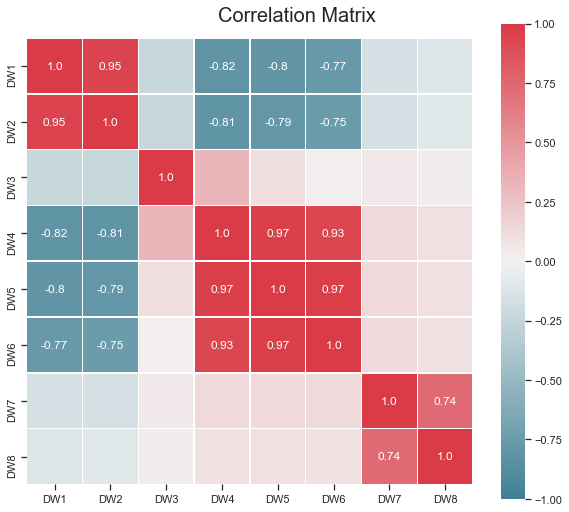

(None, None)

In [40]:
data=df.iloc[:, 61:69]
overview(data)

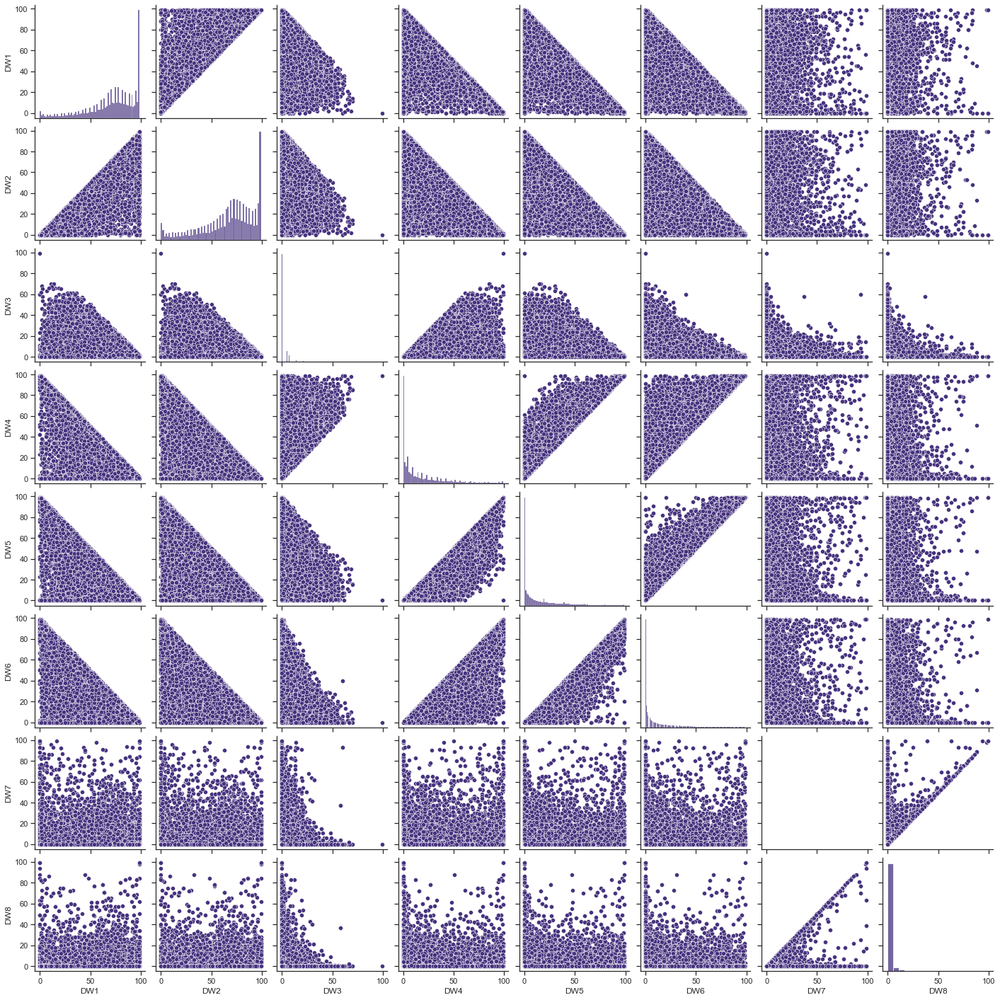

In [37]:
sns.pairplot(df.iloc[:, 61:69])
plt.show()

DW9                         Non-Institutional Group Quarters
HV1                         Median Home Value in hundreds
HV2                         Average Home Value in hundreds
HV3                         Median Contract Rent in hundreds
HV4                         Average Contract Rent in hundreds

Max percentage 
 DW9      99
HV1    6000
HV2    6000
HV3      13
HV4      13
dtype: int64
--------------------------------------------------------------
Median percentage 
 DW9      0.0
HV1    742.0
HV2    808.0
HV3      4.0
HV4      3.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 DW9    0
HV1    0
HV2    0
HV3    0
HV4    0
dtype: int64


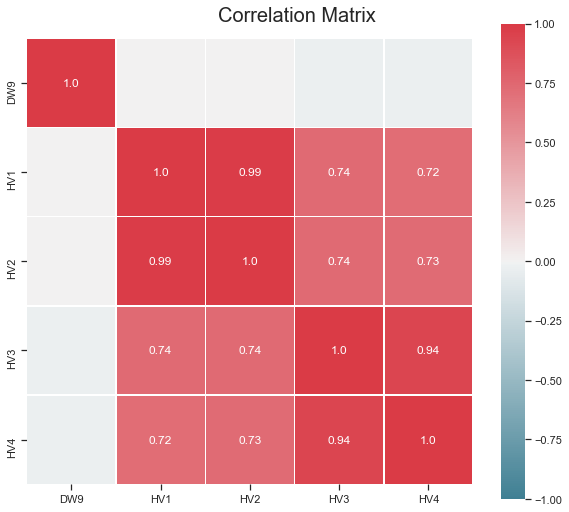

(None, None)

In [41]:
data=df.iloc[:, 69:74]
overview(data)

Max value 
 DW9      99
HV1    6000
HV2    6000
HV3      13
HV4      13
dtype: int64
--------------------------------------------------------------
Median 
 DW9      0.0
HV1    742.0
HV2    808.0
HV3      4.0
HV4      3.0
dtype: float64
--------------------------------------------------------------


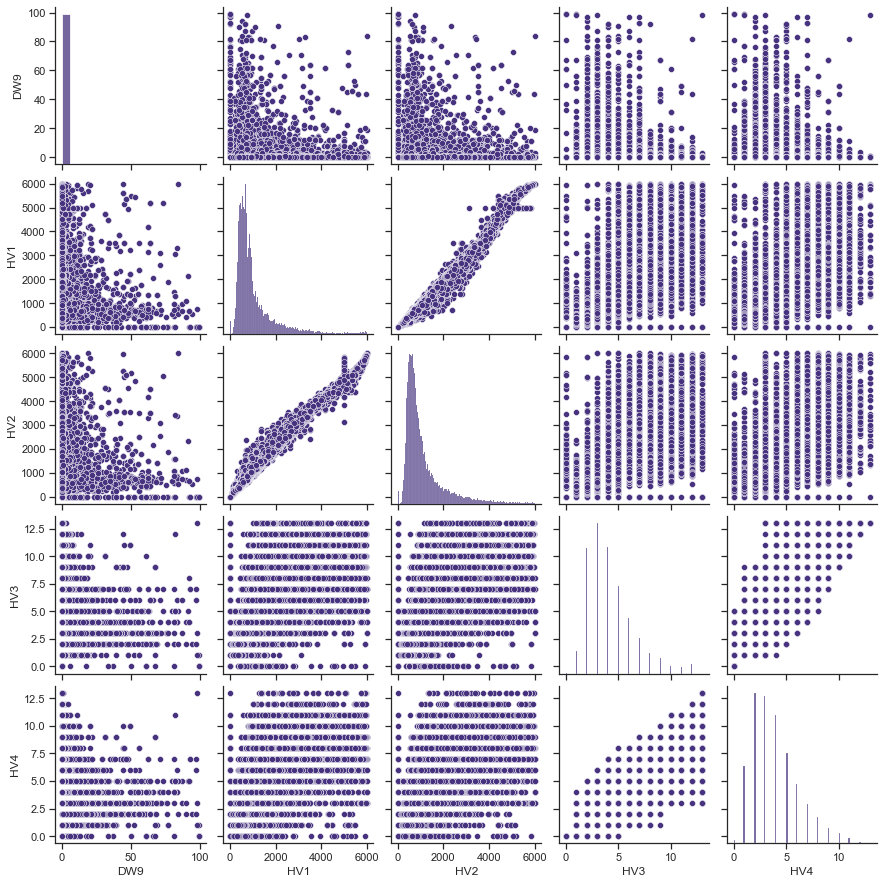

In [75]:
# Some statistics
i=df.iloc[:, 69:74]

sns.pairplot(i)
plt.show()

HU1                         Percent Owner Occupied Housing Units
HU2                         Percent Renter Occupied Housing Units
HU3                         Percent Occupied Housing Units
HU4                         Percent Vacant Housing Units
HU5                         Percent Seasonal/Recreational Vacant Units
HHD1                        Percent Households w/ Related Children
HHD2                        Percent Households w/ Families
HHD3                        Percent Married Couple Families
HHD4                        Percent Married Couples w/ Related Children
HHD5                        Percent Persons in Family Household
HHD6                        Percent Persons in Non-Family Household
HHD7                        Percent Single Parent Households
HHD8                        Percent Male Householder w/ Child
HHD9                        Percent Female Householder w/ Child
HHD10                       Percent Single Male Householder
HHD11                       Percent Single Female Householder
HHD12                       Percent Households w/ Non-Family Living Arrangements
ETHC1                       Percent White < Age 15
ETHC2                       Percent White Age 15 - 59
ETHC3                       Percent White Age 60+
ETHC4                       Percent Black < Age 15
ETHC5                       Percent Black Age 15 - 59
ETHC6                       Percent Black Age 60+
HVP1                        Percent Home Value >= $200,000
HVP2                        Percent Home Value >= $150,000
HVP3                        Percent Home Value >= $100,000
HVP4                        Percent Home Value >= $75,000
HVP5                        Percent Home Value >= $50,000
HVP6                        Percent Home Value >= $300,000

Max percentage 
 HU1      99
HU2      99
HU3      99
HU4      99
HU5      99
HHD1     99
HHD2     99
HHD3     99
HHD4     99
HHD5     99
HHD6     99
HHD7     99
HHD8     50
HHD9     99
HHD10    99
HHD11    99
HHD12    99
ETHC1    75
ETHC2    99
ETHC3    99
ETHC4    55
ETHC5    99
ETHC6    99
HVP1     99
HVP2     99
HVP3     99
HVP4     99
HVP5     99
HVP6     99
dtype: int64
--------------------------------------------------------------
Median percentage 
 HU1      76.0
HU2      24.0
HU3      94.0
HU4       6.0
HU5       5.0
HHD1     37.0
HHD2     75.0
HHD3     62.0
HHD4     28.0
HHD5     86.0
HHD6     14.0
HHD7      7.0
HHD8      1.0
HHD9      5.0
HHD10    12.0
HHD11    18.0
HHD12     4.0
ETHC1    18.0
ETHC2    55.0
ETHC3    15.0
ETHC4     0.0
ETHC5     1.0
ETHC6     0.0
HVP1      1.0
HVP2      4.0
HVP3     18.0
HVP4     49.0
HVP5     89.0
HVP6      0.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 HU1      0
HU2      0
HU3      0
HU4  

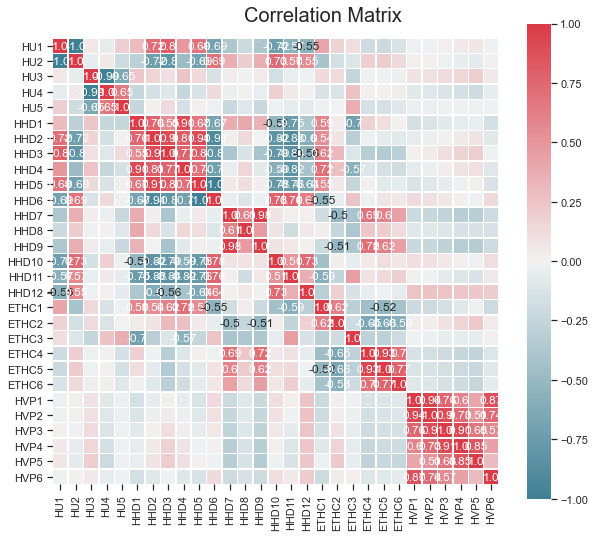

(None, None)

In [42]:
data=df.iloc[:, 74:103]
overview(data)

Max value 
 HU1      99
HU2      99
HU3      99
HU4      99
HU5      99
HHD1     99
HHD2     99
HHD3     99
HHD4     99
HHD5     99
HHD6     99
HHD7     99
HHD8     50
HHD9     99
HHD10    99
HHD11    99
HHD12    99
ETHC1    75
ETHC2    99
ETHC3    99
ETHC4    55
ETHC5    99
ETHC6    99
HVP1     99
HVP2     99
HVP3     99
HVP4     99
HVP5     99
HVP6     99
dtype: int64
--------------------------------------------------------------
Median 
 HU1      76.0
HU2      24.0
HU3      94.0
HU4       6.0
HU5       5.0
HHD1     37.0
HHD2     75.0
HHD3     62.0
HHD4     28.0
HHD5     86.0
HHD6     14.0
HHD7      7.0
HHD8      1.0
HHD9      5.0
HHD10    12.0
HHD11    18.0
HHD12     4.0
ETHC1    18.0
ETHC2    55.0
ETHC3    15.0
ETHC4     0.0
ETHC5     1.0
ETHC6     0.0
HVP1      1.0
HVP2      4.0
HVP3     18.0
HVP4     49.0
HVP5     89.0
HVP6      0.0
dtype: float64
--------------------------------------------------------------


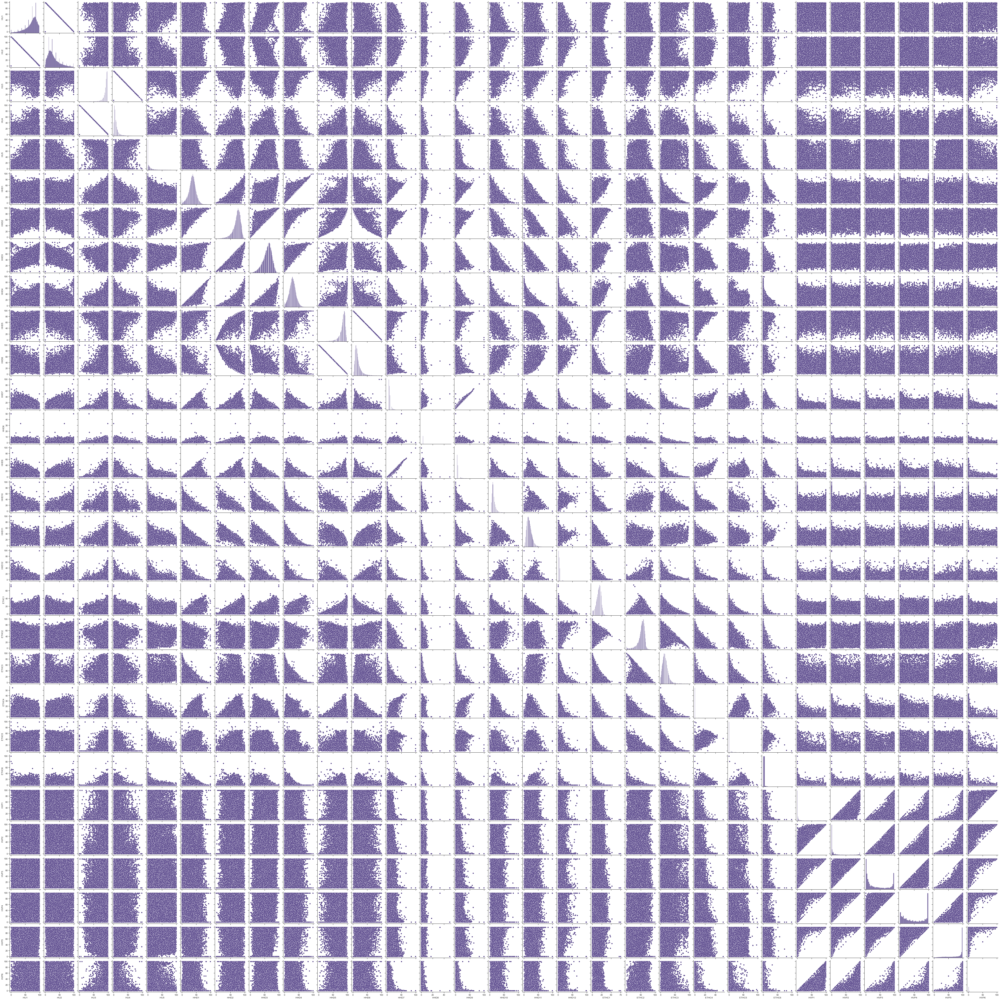

In [76]:
# Some statistics
i=df.iloc[:, 74:103]
print('Max value \n', i.max())

print('--------------------------------------------------------------')

print('Median \n' , i.median())

print('--------------------------------------------------------------')

sns.pairplot(i)
plt.show()

HUR1                        $ 1 or 2 Room Housing Units
HUR2                        Percent >= 6 Room Housing Units
RHP1                        Median Number of Rooms per Housing Unit
RHP2                        Average Number of Rooms per Housing Unit
RHP3                        Median Number of Persons per Housing Unit
RHP4                        Average Number of Persons per Room

Max percentage 
 HUR1    99
HUR2    99
RHP1    85
RHP2    90
RHP3    61
RHP4    40
dtype: int64
--------------------------------------------------------------
Median percentage 
 HUR1     2.0
HUR2    44.0
RHP1    52.0
RHP2    54.0
RHP3    14.0
RHP4     4.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 HUR1     0
HUR2     0
RHP1     0
RHP2     0
RHP3    10
RHP4     0
dtype: int64


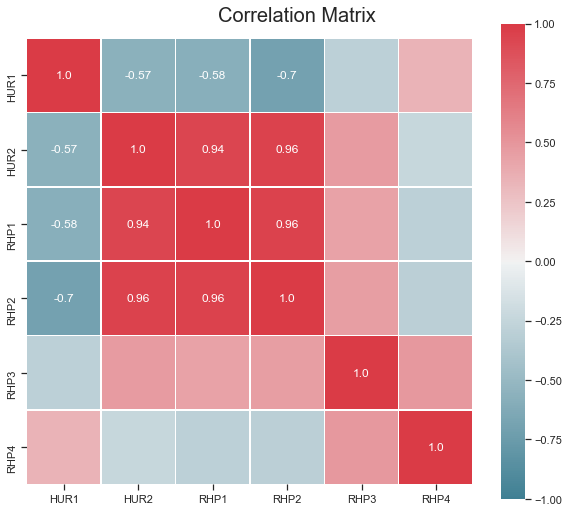

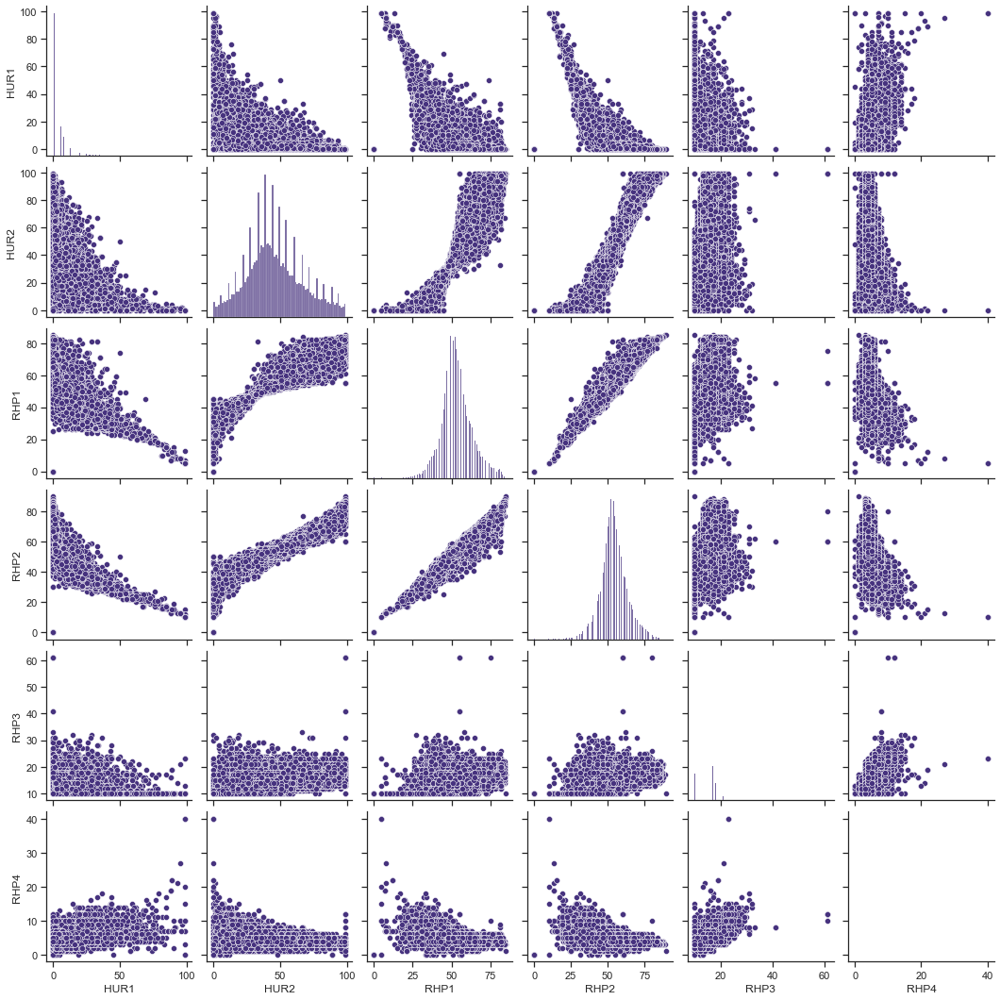

In [44]:
data=df.iloc[:, 103:109]
overview(data)
pairplot(data)

HUPA1                       Percent Housing Units w/ 2 thru 9 Units at the Address
HUPA2                       Percent Housing Units w/ >= 10 Units at the Address
HUPA3                       Percent Mobile Homes or Trailers
HUPA4                       Percent Renter Occupied Single Unit Structure
HUPA5                       Percent Renter Occupied, 2 - 4 Units
HUPA6                       Percent Renter Occupied, 5+ Units
HUPA7                       Percent Renter Occupied Mobile Homes or Trailers
RP1                         Percent Renters Paying >= $500 per Month
RP2                         Percent Renters Paying >= $400 per Month
RP3                         Percent Renters Paying >= $300 per Month
RP4                         Percent Renters Paying >= $200 per Month

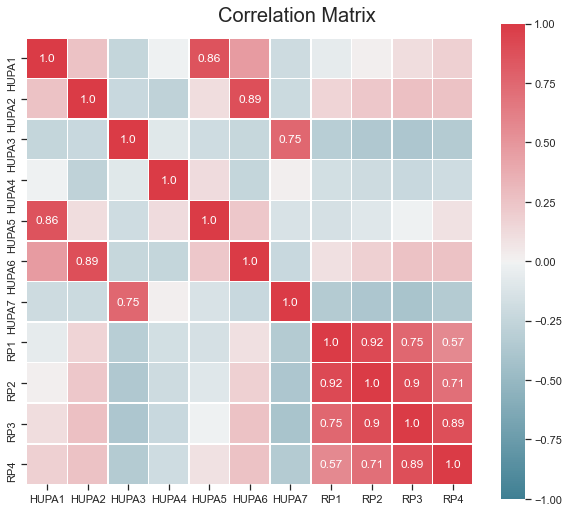

In [45]:
data=df.iloc[:, 109:120]
correlation_matrix(data)

Max value 
 HUPA1    99
HUPA2    99
HUPA3    99
HUPA4    99
HUPA5    99
HUPA6    99
HUPA7    99
RP1      99
RP2      99
RP3      99
RP4      99
dtype: int64
--------------------------------------------------------------
Median 
 HUPA1     6.0
HUPA2     1.0
HUPA3     0.0
HUPA4    10.0
HUPA5     2.0
HUPA6     2.0
HUPA7     0.0
RP1      14.0
RP2      37.0
RP3      69.0
RP4      86.0
dtype: float64
--------------------------------------------------------------


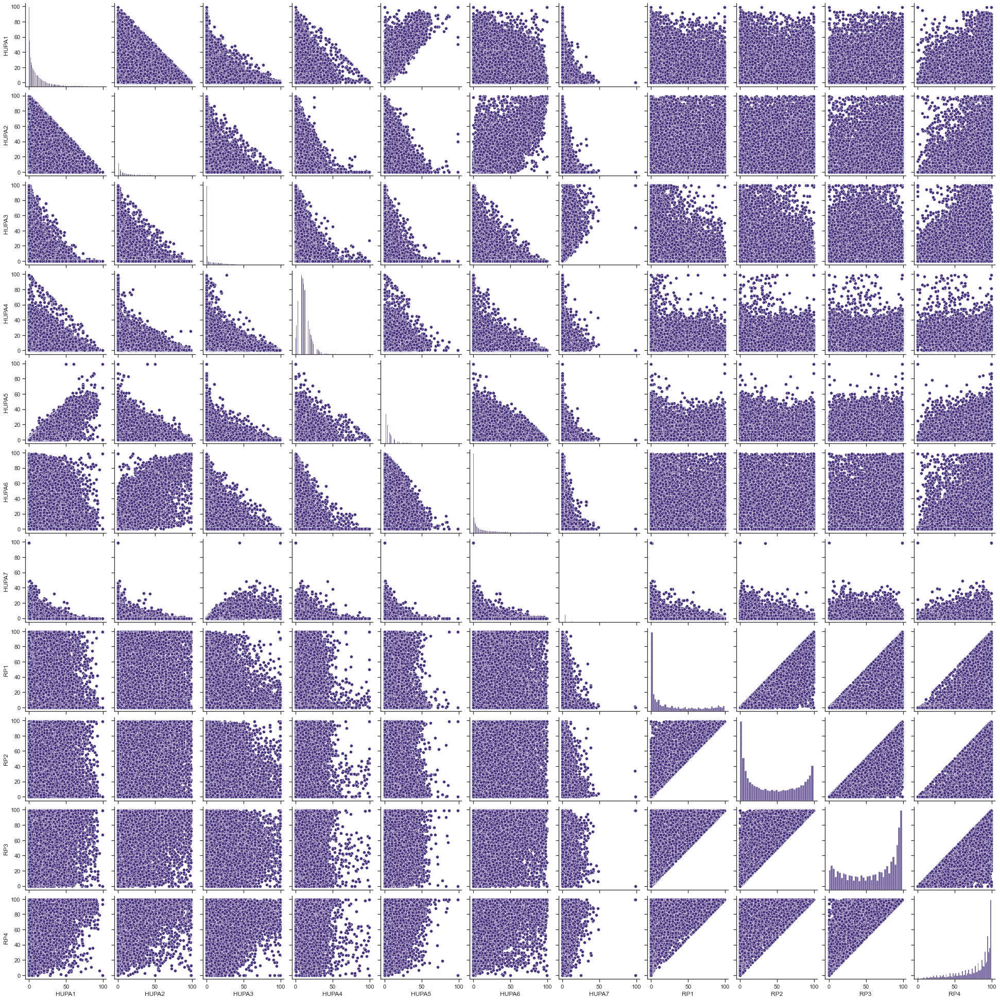

In [78]:
# Some statistics
i=df.iloc[:, 109:120]
print('Max value \n', i.max())

print('--------------------------------------------------------------')

print('Median \n' , i.median())

print('--------------------------------------------------------------')

sns.pairplot(i)
plt.show()

MSA                         MSA Code   METROPOLITAN STATISTICAL AREA
ADI                         ADI Code   Area Deprivation Index (rankings of neighborhoods by                                                                            socioeconomic status)
DMA                         DMA Code Designated Market Area (particular television market)

In [46]:
print('Unique values for MSA:',len(df.MSA.unique()),
      '\nUnique values for ADI:',len(df.ADI.unique()),
      '\nUnique values for DMA:',len(df.DMA.unique()))

Unique values for MSA: 298 
Unique values for ADI: 204 
Unique values for DMA: 206


Max percentage 
 MSA    9360.0
ADI     651.0
DMA     881.0
dtype: float64
--------------------------------------------------------------
Median percentage 
 MSA    3350.0
ADI     175.0
DMA     635.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 MSA    0.0
ADI    0.0
DMA    0.0
dtype: float64


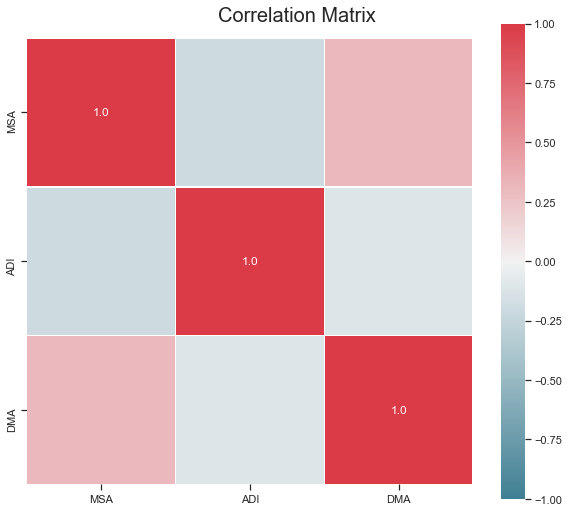

(None, None)

In [48]:
data=df.iloc[:, 120:123]
overview(data)

Max value 
 MSA    9360.0
ADI     651.0
DMA     881.0
dtype: float64
--------------------------------------------------------------
Median 
 MSA    3350.0
ADI     175.0
DMA     635.0
dtype: float64
--------------------------------------------------------------
Min 
 MSA    0.0
ADI    0.0
DMA    0.0
dtype: float64


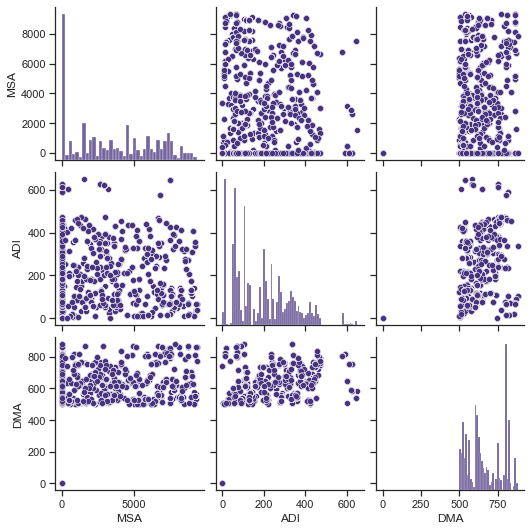

In [80]:
# Some statistics
i=df.iloc[:, 120:123]
print('Max value \n', i.max())

print('--------------------------------------------------------------')

print('Median \n' , i.median())

print('--------------------------------------------------------------')

print('Min \n' , i.min())
sns.pairplot(i)
plt.show()

IC1                         Median Household Income in hundreds
IC2                         Median Family Income in hundreds
IC3                         Average Household Income in hundreds
IC4                         Average Family Income in hundreds
IC5                         Per Capita Income

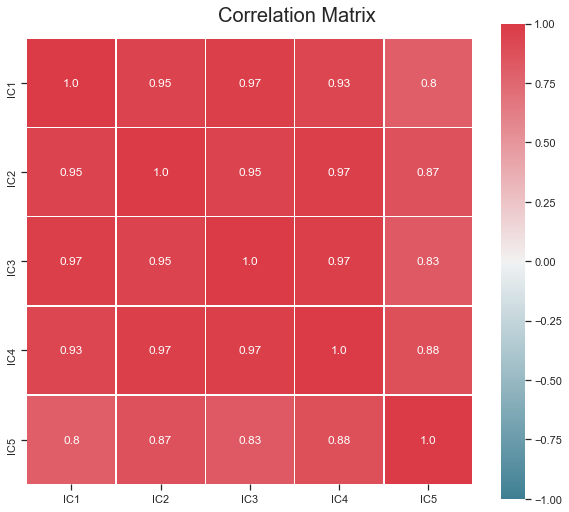

In [49]:
data=df.iloc[:, 123:128]
correlation_matrix(data)

Max value 
 IC1      1500
IC2      1500
IC3      1500
IC4      1500
IC5    174523
dtype: int64
--------------------------------------------------------------
Median 
 IC1      311.0
IC2      357.0
IC3      355.0
IC4      398.0
IC5    13789.0
dtype: float64
--------------------------------------------------------------


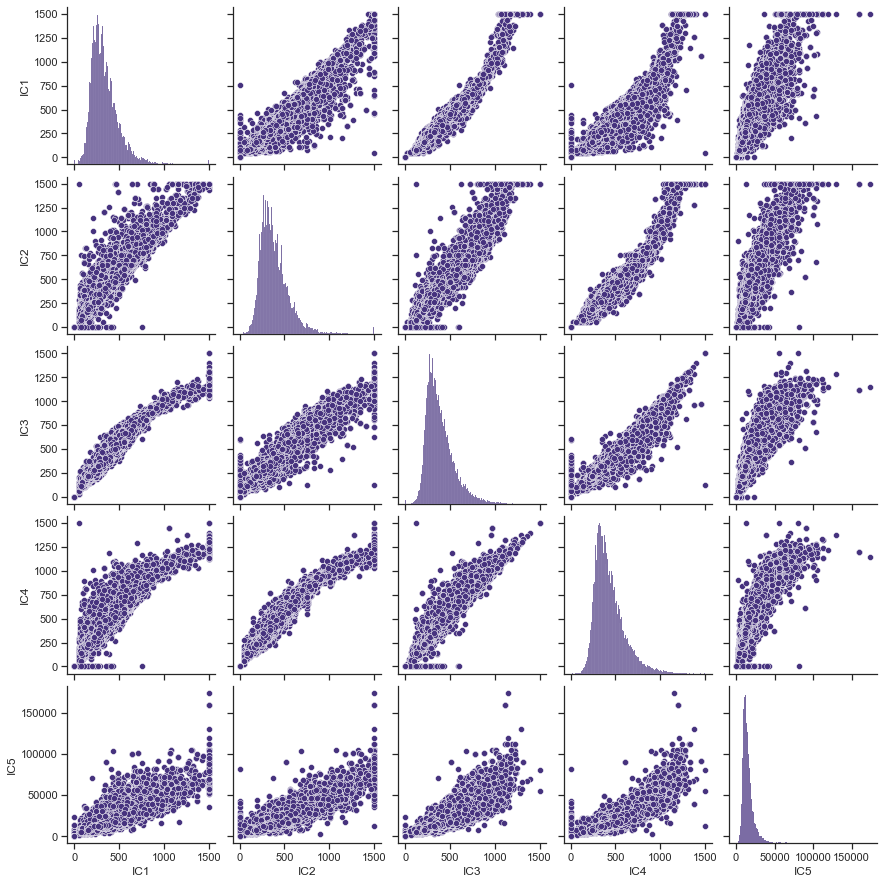

In [88]:
# Some statistics
i=df.iloc[:, 123:128]
print('Max value \n', i.max())

print('--------------------------------------------------------------')

print('Median \n' , i.median())

print('--------------------------------------------------------------')

sns.pairplot(i)
plt.show()

IC6                         Percent Households w/ Income < $15,000
IC7                         Percent Households w/ Income $15,000 - $24,999
IC8                         Percent Households w/ Income $25,000 - $34,999
IC9                         Percent Households w/ Income $35,000 - $49,999
IC10                        Percent Households w/ Income $50,000 - $74,999
IC11                        Percent Households w/ Income $75,000 - $99,999
IC12                        Percent Households w/ Income $100,000 - $124,999
IC13                        Percent Households w/ Income $125,000 - $149,999
IC14                        Percent Households w/ Income >= $150,000
IC15                        Percent Families w/ Income < $15,000
IC16                        Percent Families w/ Income $15,000 - $24,999
IC17                        Percent Families w/ Income $25,000 - 34,999
IC18                        Percent Families w/ Income $35,000 - $49,999
IC19                        Percent Families w/ Income $50,000 - $74,999
IC20                        Percent Families w/ Income $75,000 - $99,999
IC21                        Percent Families w/ Income $100,000 - $124,999
IC22                        Percent Families w/ Income $125,000 - $149,999
IC23                        Percent Families w/ Income >= $150,000
HHAS1                       Percent Households on Social Security
HHAS2                       Percent Households on Public Assistance
HHAS3                       Percent Households w/ Interest, Rental or Dividend Income
HHAS4                       Percent Persons Below Poverty Level
MC1                         Percent Persons Move in Since 2005
MC2                         Percent Persons in Same House in 2005
MC3                         Percent Persons in Different State/Country in 2005
TPE1                        Percent Driving to Work Alone Car/Truck/Van
TPE2                        Percent Carpooling Car/Truck/Van)
TPE3                        Percent Using Public Transportation
TPE4                        Percent Using Bus/Trolley
TPE5                        Percent Using Railways
TPE6                        Percent Using Taxi/Ferry
TPE7                        Percent Using Motorcycles
TPE8                        Percent Using Other Transportation
TPE9                        Percent Working at Home/No Transportation
PEC1                        Percent Working Outside State of Residence
PEC2                        Percent Working Outside County of Residence in State

Max percentage 
 IC6      99
IC7      99
IC8      99
IC9      99
IC10     99
IC11     99
IC12     50
IC13     61
IC14     99
IC15     99
IC16     99
IC17     99
IC18     99
IC19     99
IC20     99
IC21     50
IC22     99
IC23     99
HHAS1    99
HHAS2    99
HHAS3    99
HHAS4    99
MC1      99
MC2      99
MC3      99
TPE1     99
TPE2     99
TPE3     99
TPE4     99
TPE5     71
TPE6     47
TPE7     25
TPE8     99
TPE9     99
PEC1     99
PEC2     99
dtype: int64
--------------------------------------------------------------
Median percentage 
 IC6      19.0
IC7      17.0
IC8      16.0
IC9      18.0
IC10     15.0
IC11      4.0
IC12      1.0
IC13      0.0
IC14      0.0
IC15     12.0
IC16     16.0
IC17     17.0
IC18     21.0
IC19     18.0
IC20      5.0
IC21      1.0
IC22      0.0
IC23      0.0
HHAS1    26.0
HHAS2     4.0
HHAS3    43.0
HHAS4     8.0
MC1      47.0
MC2      53.0
MC3      10.0
TPE1     79.0
TPE2     12.0
TPE3      0.0
TPE4      0.0
TPE5      0.0
TPE6      0.0
TPE7      0.0
TPE8   

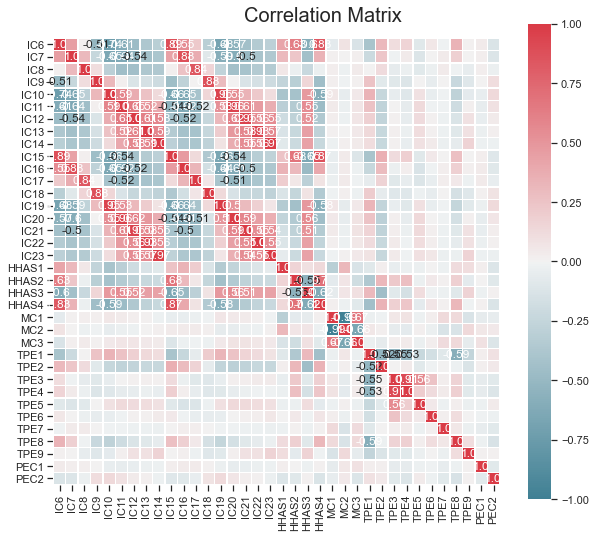

(None, None)

In [50]:
data=df.iloc[:, 128:164]
overview(data)

TPE10                       Median Travel Time to Work in minutes
TPE11                       Mean Travel Time to Work in minutes

Max percentage 
 TPE10    90
TPE11    76
dtype: int64
--------------------------------------------------------------
Median percentage 
 TPE10    19.0
TPE11    23.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 TPE10    0
TPE11    0
dtype: int64


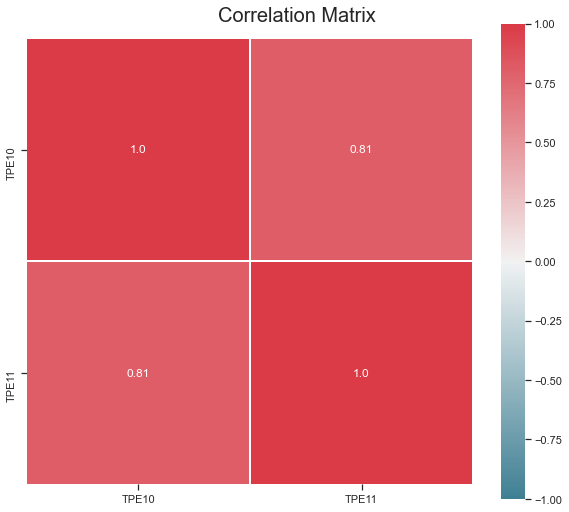

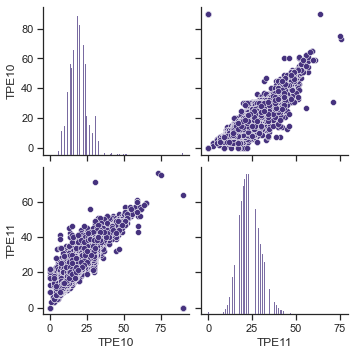

In [52]:
i=df.iloc[:, 164:166]
overview(i)
pairplot(i)

TPE12                       Percent Traveling 60+ Minutes to Work
TPE13                       Percent Traveling 15 - 59 Minutes to Work
LFC1                        Percent Adults in Labor Force
LFC2                        Percent Adult Males in Labor Force
LFC3                        Percent Females in Labor Force
LFC4                        Percent Adult Males Employed
LFC5                        Percent Adult Females Employed
LFC6                        Percent Mothers Employed Married and Single
LFC7                        Percent 2 Parent Earner Families
LFC8                        Percent Single Mother w/ Child in Labor Force
LFC9                        Percent Single Father w/ Child in Labor Force
LFC10                       Percent Families w/ Child w/ no Workers
OCC1                        Percent Professional
OCC2                        Percent Managerial
OCC3                        Percent Technical
OCC4                        Percent Sales
OCC5                        Percent Clerical/Administrative Support
OCC6                        Percent Private Household Service Occ.
OCC7                        Percent Protective Service Occ.
OCC8                        Percent Other Service Occ.
OCC9                        Percent Farmers
OCC10                       Percent Craftsmen, Precision, Repair
OCC11                       Percent Operatives, Machine
OCC12                       Percent Transportation
OCC13                       Percent Laborers, Handlers, Helpers
EIC1                        Percent Employed in Agriculture
EIC2                        Percent Employed in Mining
EIC3                        Percent Employed in Construction
EIC4                        Percent Employed in Manufacturing
EIC5                        Percent Employed in Transportation
EIC6                        Percent Employed in Communications
EIC7                        Percent Employed in Wholesale Trade
EIC8                        Percent Employed in Retail Industry
EIC9                        Percent Employed in Finance, Insurance, Real Estate
EIC10                       Percent Employed in Business and Repair
EIC11                       Percent Employed in Personnal Services
EIC12                       Percent Employed in Entertainment and Recreation
EIC13                       Percent Employed in Health Services
EIC14                       Percent Employed in Educational Services
EIC15                       Percent Employed in Other Professional Services
EIC16                       Percent Employed in Public Administration
OEDC1                       Percent Employed by Local Government
OEDC2                       Percent Employed by State Government
OEDC3                       Percent Employed by Federal Government
OEDC4                       Percent Self Employed
OEDC5                       Percent Private Profit Wage or Salaried Worker
OEDC6                       Percent Private Non-Profit Wage or Salaried Worker
OEDC7                       Percent Unpaid Family Workers

Max percentage 
 TPE12    99
TPE13    99
LFC1     99
LFC2     99
LFC3     99
LFC4     99
LFC5     99
LFC6     99
LFC7     99
LFC8     99
LFC9     99
LFC10    99
OCC1     99
OCC2     99
OCC3     99
OCC4     99
OCC5     99
OCC6     43
OCC7     55
OCC8     99
OCC9     99
OCC10    99
OCC11    99
OCC12    99
OCC13    99
EIC1     99
EIC2     65
EIC3     99
EIC4     99
EIC5     99
EIC6     64
EIC7     99
EIC8     99
EIC9     99
EIC10    99
EIC11    99
EIC12    67
EIC13    99
EIC14    99
EIC15    99
EIC16    99
OEDC1    99
OEDC2    99
OEDC3    99
OEDC4    99
OEDC5    99
OEDC6    99
OEDC7    99
dtype: int64
--------------------------------------------------------------
Median percentage 
 TPE12     4.0
TPE13    64.0
LFC1     66.0
LFC2     76.0
LFC3     57.0
LFC4     72.0
LFC5     54.0
LFC6     66.0
LFC7     50.0
LFC8     78.0
LFC9     97.0
LFC10     4.0
OCC1     13.0
OCC2     11.0
OCC3      3.0
OCC4     12.0
OCC5     15.0
OCC6      0.0
OCC7      1.0
OCC8     10.0
OCC9      1.0
OCC10    11.0
OCC

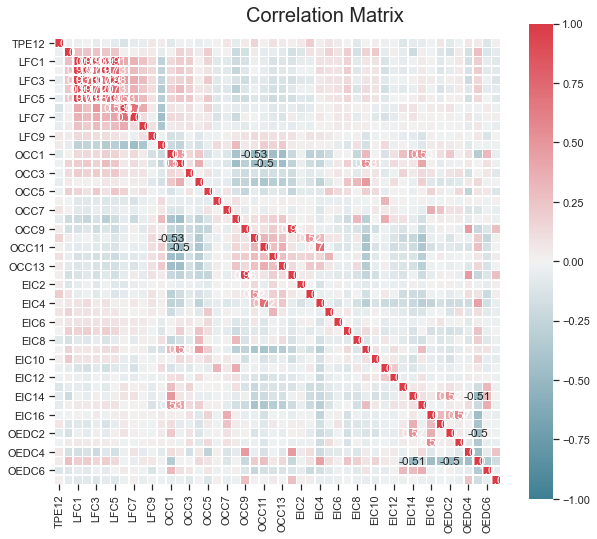

(None, None)

In [53]:
i=df.iloc[:, 166:214]
overview(i)

EC1                         Median Years of School Completed by Adults 25+

In [54]:
statistical_summary(df.iloc[:, 214])

Max percentage 
 170
--------------------------------------------------------------
Median percentage 
 120.0
--------------------------------------------------------------
Min percentage 
 89


EC2                         Percent Adults 25+ Grades 0-8
EC3                         Percent Adults 25+ w/ some High School
EC4                         Percent Adults 25+ Completed High School or Equivalency
EC5                         Percent Adults 25+ w/ some College
EC6                         Percent Adults 25+ w/ Associates Degree
EC7                         Percent Adults 25+ w/ Bachelors Degree
EC8                         Percent Adults 25+ Graduate Degree
SEC1                        Percent Persons Enrolled in Private Schools
SEC2                        Percent Persons Enrolled in Public Schools
SEC3                        Percent Persons Enrolled in Preschool
SEC4                        Percent Persons Enrolled in Elementary or High School
SEC5                        Percent Persons in College
AFC1                        Percent Adults in Active Military Service
AFC2                        Percent Males in Active Military Service
AFC3                        Percent Females in Active Military Service
AFC4                        Percent Adult Veterans Age 16+
AFC5                        Percent Male Veterans Age 16+
AFC6                        Percent Female Veterans Age 16+
VC1                         Percent Vietnam Veterans Age 16+
VC2                         Percent Korean Veterans Age 16+
VC3                         Percent WW2 Veterans Age 16+
VC4                         Percent Veterans Serving After May 1995 Only
ANC1                        Percent Dutch Ancestry
ANC2                        Percent English Ancestry
ANC3                        Percent French Ancestry
ANC4                        Percent German Ancestry
ANC5                        Percent Greek Ancestry
ANC6                        Percent Hungarian Ancestry
ANC7                        Percent Irish Ancestry
ANC8                        Percent Italian Ancestry
ANC9                        Percent Norwegian Ancestry
ANC10                       Percent Polish Ancestry
ANC11                       Percent Portuguese Ancestry
ANC12                       Percent Russian Ancestry
ANC13                       Percent Scottish Ancestry
ANC14                       Percent Swedish Ancestry
ANC15                       Percent Ukranian Ancestry
POBC1                       Percent Foreign Born
POBC2                       Percent Born in State of Residence
LSC1                        Percent English Only Speaking
LSC2                        Percent Spanish Speaking
LSC3                        Percent Asian Speaking
LSC4                        Percent Other Language Speaking
VOC1                        Percent Households w/ 1+ Vehicles
VOC2                        Percent Households w/ 2+ Vehicles
VOC3                        Percent Households w/ 3+ Vehicles
HC1                         Percent Median Length of Residence
HC2                         Percent Median Age of Occupied Dwellings in years
HC3                         Percent Owner Occupied Structures Built Since 2009
HC4                         Percent Owner Occupied Structures Built Since 2005
HC5                         Percent Owner Occupied Structures Built Since 2000
HC6                         Percent Owner Occupied Structures Built Since 1990
HC7                         Percent Owner Occupied Structures Built Since 1980
HC8                         Percent Owner Occupied Structures Built Prior to 1860
HC9                         Percent Owner Occupied Condominiums
HC10                        Percent Renter Occupied Condominiums
HC11                        Percent Occupied Housing Units Heated by Utility Gas
HC12                        Percent Occupied Housing Units Heated by Bottled, Tank or LP
HC13                        Percent Occupied Housing Units Heated by Electricity
HC14                        Percent Occupied Housing Units Heated by Fuel Oil
HC15                        Percent Occupied Housing Units Heated by Solar Energy
HC16                        Percent Occupied Housing Units Heated by Coal, Wood, Other
HC17                        Percent Housing Units w/ Public Water Source
HC18                        Percent Housing Units w/ Well Water Source
HC19                        Percent Housing Units w/ Public Sewer Source
HC20                        Percent Housing Units w/ Complete Plumbing Facilities
HC21                        Percent Housing Units w/ Telephones

Max percentage 
 EC1      170
EC2       99
EC3       99
EC4       99
EC5       99
EC6       37
EC7       99
EC8       99
SEC1      97
SEC2      99
SEC3      30
SEC4      72
SEC5      99
AFC1      97
AFC2      99
AFC3      78
AFC4      99
AFC5      99
AFC6      30
VC1       99
VC2       99
VC3       99
VC4       99
ANC1      83
ANC2      99
ANC3      31
ANC4      92
ANC5      47
ANC6      14
ANC7      99
ANC8      55
ANC9      68
ANC10     99
ANC11     43
ANC12     52
ANC13     50
ANC14     27
ANC15     32
POBC1     99
POBC2     99
LSC1      99
LSC2      99
LSC3      99
LSC4      99
VOC1      99
VOC2      99
VOC3      99
HC1       31
HC2       52
HC3       99
HC4       99
HC5       99
HC6       99
HC7       99
HC8       99
HC9       90
HC10      62
HC11      99
HC12      99
HC13      99
dtype: int64
--------------------------------------------------------------
Median percentage 
 EC1      120.0
EC2        6.0
EC3       12.0
EC4       29.0
EC5       21.0
EC6        6.0
EC7       12.0
EC

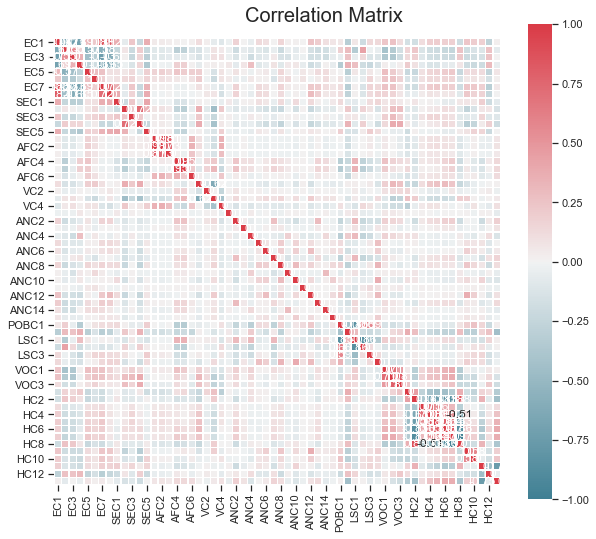

(None, None)

In [55]:
i=df.iloc[:, 214:274]
overview(i)

MHUC1                       Median Homeowner Cost w/ Mortgage per Month dollars
MHUC2                       Median Homeowner Cost w/out Mortgage per Month dollars

Max percentage 
 MHUC1    21
MHUC2     5
dtype: int64
--------------------------------------------------------------
Median percentage 
 MHUC1    8.0
MHUC2    2.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 MHUC1    0
MHUC2    0
dtype: int64


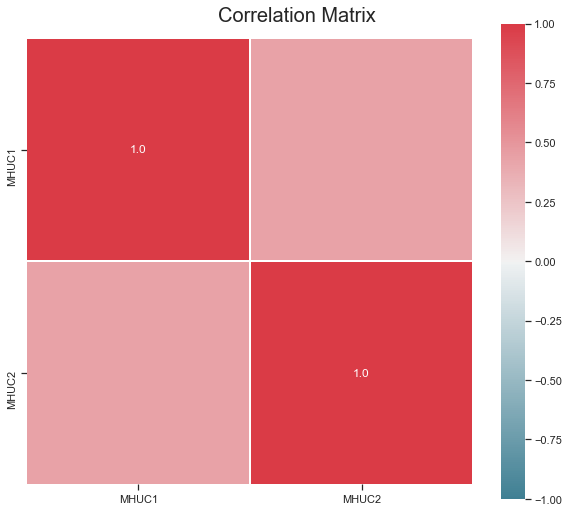

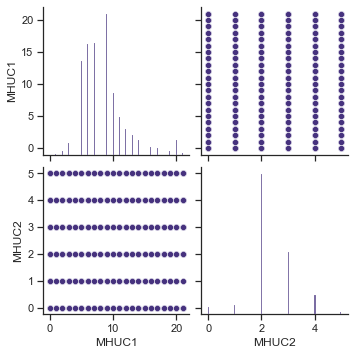

In [57]:
i=df.iloc[:, 282:284]
overview(i)
pairplot(i)

AC1                         Percent Adults Age 55-59
AC2                         Percent Adults Age 60-64

Max percentage 
 AC1    99
AC2    99
dtype: int64
--------------------------------------------------------------
Median percentage 
 AC1    6.0
AC2    6.0
dtype: float64
--------------------------------------------------------------
Min percentage 
 AC1    0
AC2    0
dtype: int64


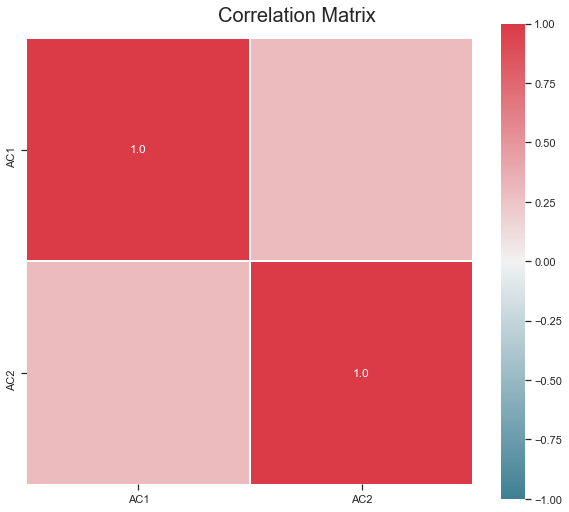

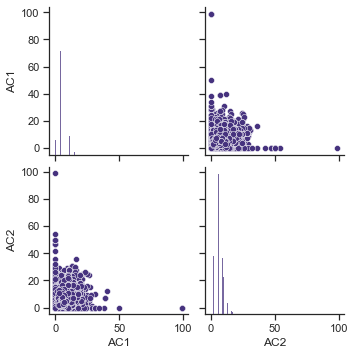

In [58]:
i=df.iloc[:, 284:286]
overview(i)
pairplot(i)

# Considering the ones that are not percentages

POP901                      Number of Persons
POP902                      Number of Families
POP903                      Number of Households

AGE901                      Median Age of Population
AGE902                      Median Age of Adults 18 or Older
AGE903                      Median Age of Adults 25 or Older
AGE904                      Average Age of Population
AGE905                      Average Age of Adults >= 18
AGE906                      Average Age of Adults >= 25

HHP1                        Median Person Per Household
HHP2                        Average Person Per Household

DW9                         Non-Institutional Group Quarters
HV1                         Median Home Value in hundreds
HV2                         Average Home Value in hundreds
HV3                         Median Contract Rent in hundreds
HV4                         Average Contract Rent in hundreds

HUR1                        $ 1 or 2 Room Housing Units
RHP1                        Median Number of Rooms per Housing Unit
RHP2                        Average Number of Rooms per Housing Unit
RHP3                        Median Number of Persons per Housing Unit
RHP4                        Average Number of Persons per Room

MSA                         MSA Code   METROPOLITAN STATISTICAL AREA
ADI                         ADI Code   Area Deprivation Index (rankings of neighborhoods by                                                                            socioeconomic status)
DMA                         DMA Code Designated Market Area (particular television market)

IC1                         Median Household Income in hundreds
IC2                         Median Family Income in hundreds
IC3                         Average Household Income in hundreds
IC4                         Average Family Income in hundreds
IC5                         Per Capita Income

TPE10                       Median Travel Time to Work in minutes
TPE11                       Mean Travel Time to Work in minutes

EC1                         Median Years of School Completed by Adults 25+

MHUC1                       Median Homeowner Cost w/ Mortgage per Month dollars
MHUC2                       Median Homeowner Cost w/out Mortgage per Month dollars

In [16]:
not_percentages = df[['POP901','POP902','POP903','AGE901','AGE902','AGE903','AGE904','AGE905','AGE906','HHP1','HHP2','DW9','HV1','HV2','HV3','HV4','HUR1','RHP1','RHP2','RHP3','RHP4','MSA','ADI','DMA','IC1','IC2','IC3','IC4','IC5','TPE10','TPE11','EC1','MHUC1','MHUC2']]

Data Normalizing

I have values that have different scales, thus I have to normalize or the PCA will catch only the variance of the variables with the biggest values (and biggest variances)

In [ ]:
# Handle problem of the ['MSA','ADI','DMA'], they are codes, so probably I don't have to consider them as metric

In [63]:
# Define metric and non-metric features. Why?
metric_features = ['POP901','POP902','POP903','AGE901','AGE902','AGE903','AGE904','AGE905','AGE906','HHP1','HHP2','DW9','HV1','HV2','HV3','HV4','HUR1','RHP1','RHP2','RHP3','RHP4','IC1','IC2','IC3','IC4','IC5','TPE10','TPE11','EC1','MHUC1','MHUC2']
non_metric_features = ['MSA','ADI','DMA']

In [64]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder

In [65]:
df_standard = not_percentages.copy()

In [66]:
# Using the Standard scaler
scaler = StandardScaler()
scaled_feat = scaler.fit_transform(df_standard[metric_features])
scaled_feat

array([[-0.39783907, -0.41605475, -0.42314681, ..., -0.67224713,
        -0.62937476, -0.41640596],
       [ 0.05688359,  0.04630591, -0.11033029, ...,  2.29613922,
         3.4099814 ,  1.95464705],
       [ 0.64547076,  0.79866792,  0.67452916, ..., -0.67224713,
         0.23620156, -0.41640596],
       ...,
       [-0.47423387, -0.50702215, -0.482798  , ..., -0.67224713,
        -0.9179002 , -0.41640596],
       [-0.26692617, -0.30114855, -0.34048058, ...,  0.81194605,
         1.10177788,  0.76912055],
       [ 0.11313794,  0.2186652 ,  0.0512446 , ...,  0.81194605,
        -0.05232388,  0.76912055]])

In [67]:
df_standard[metric_features] = scaled_feat
df_standard.head()

,POP901,POP902,POP903,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,HHP1,...,IC1,IC2,IC3,IC4,IC5,TPE10,TPE11,EC1,MHUC1,MHUC2
0,-0.397839,-0.416055,-0.423147,0.546797,0.782782,0.787336,0.581889,0.873422,1.073768,0.236249,...,-0.223809,-0.423654,-0.263938,-0.336463,-0.350681,-0.869227,-1.260231,-0.672247,-0.629375,-0.416406
1,0.056884,0.046306,-0.110330,-0.098988,-0.172706,-0.355715,-0.649850,-0.544376,-0.619831,2.754567,...,4.641320,4.135448,4.022127,3.592743,2.397184,0.677135,1.284400,2.296139,3.409981,1.954647
2,0.645471,0.798668,0.674529,0.030169,0.100291,0.072929,0.119987,-0.012702,0.132880,-0.081186,...,-0.572653,-0.576015,-0.624803,-0.563033,-0.504874,-0.096046,0.012084,-0.672247,0.236202,-0.416406
3,-0.458955,-0.487187,-0.476222,-0.357302,-0.309204,-0.212834,-0.341915,-0.367151,-0.243476,0.257411,...,0.268310,-0.013452,0.033617,-0.068156,-0.085592,-1.023863,-1.419270,-0.672247,2.255880,-0.416406
4,-0.132541,-0.167775,-0.221648,-0.228145,0.373287,0.644454,-0.033980,0.164523,0.321057,1.019256,...,-0.641176,-0.822136,-0.618472,-0.676318,-0.710150,0.677135,0.489203,-0.672247,-0.629375,-0.416406


In [68]:
# Checking mean and variance of standardized variables
df_standard.describe().round(2)

,POP901,POP902,POP903,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,HHP1,...,IC1,IC2,IC3,IC4,IC5,TPE10,TPE11,EC1,MHUC1,MHUC2
count,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,...,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00,94613.00
mean,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,...,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-0.57,-0.60,-0.58,-3.46,-3.18,-2.64,-3.73,-4.62,-4.01,-3.95,...,-2.14,-2.29,-2.47,-2.59,-1.87,-3.03,-3.80,-2.97,-2.36,-2.79
25%,-0.40,-0.41,-0.40,-0.62,-0.58,-0.64,-0.65,-0.54,-0.62,-0.59,...,-0.68,-0.68,-0.71,-0.70,-0.59,-0.56,-0.62,-0.67,-0.63,-0.42
50%,-0.30,-0.31,-0.30,-0.23,-0.17,-0.21,-0.19,-0.01,-0.06,-0.10,...,-0.20,-0.20,-0.23,-0.22,-0.24,-0.10,-0.15,-0.67,-0.05,-0.42
75%,-0.03,-0.02,-0.03,0.29,0.37,0.36,0.43,0.52,0.51,0.51,...,0.46,0.44,0.48,0.48,0.28,0.52,0.65,0.81,0.24,0.77
max,16.57,15.66,16.05,6.36,5.70,5.50,7.36,6.90,6.72,9.80,...,7.21,6.50,7.02,6.35,18.72,10.88,8.28,3.04,3.70,3.14


In [69]:
df_standard.head()

,POP901,POP902,POP903,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,HHP1,...,IC1,IC2,IC3,IC4,IC5,TPE10,TPE11,EC1,MHUC1,MHUC2
0,-0.397839,-0.416055,-0.423147,0.546797,0.782782,0.787336,0.581889,0.873422,1.073768,0.236249,...,-0.223809,-0.423654,-0.263938,-0.336463,-0.350681,-0.869227,-1.260231,-0.672247,-0.629375,-0.416406
1,0.056884,0.046306,-0.110330,-0.098988,-0.172706,-0.355715,-0.649850,-0.544376,-0.619831,2.754567,...,4.641320,4.135448,4.022127,3.592743,2.397184,0.677135,1.284400,2.296139,3.409981,1.954647
2,0.645471,0.798668,0.674529,0.030169,0.100291,0.072929,0.119987,-0.012702,0.132880,-0.081186,...,-0.572653,-0.576015,-0.624803,-0.563033,-0.504874,-0.096046,0.012084,-0.672247,0.236202,-0.416406
3,-0.458955,-0.487187,-0.476222,-0.357302,-0.309204,-0.212834,-0.341915,-0.367151,-0.243476,0.257411,...,0.268310,-0.013452,0.033617,-0.068156,-0.085592,-1.023863,-1.419270,-0.672247,2.255880,-0.416406
4,-0.132541,-0.167775,-0.221648,-0.228145,0.373287,0.644454,-0.033980,0.164523,0.321057,1.019256,...,-0.641176,-0.822136,-0.618472,-0.676318,-0.710150,0.677135,0.489203,-0.672247,-0.629375,-0.416406


In [70]:
# coping the result of the standardization of the variables to the dataset not_percentages
not_percentages = df_standard.copy()

Principal Component Analysis of the variables not_percentages

In [26]:
from sklearn.decomposition import PCA

In [71]:
# Creating a copy of the dataset to compute the principal component analysis
df_pca = not_percentages.copy()

In [72]:
# Use PCA to reduce dimensionality of data

# Calculating the components

pca = PCA()
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat 

array([[-1.54210667e+00, -1.26775681e+00, -2.26925427e+00, ...,
        -4.78648706e-02,  5.30386891e-02, -6.70946249e-02],
       [ 1.32283338e+01,  9.67417103e-01, -1.79709347e-01, ...,
         1.64566777e-01, -8.45419911e-03, -1.17318541e-02],
       [-2.14688022e+00,  3.38050117e-01,  4.49930135e-01, ...,
         1.57359324e-02,  4.83501763e-02, -8.58898029e-02],
       ...,
       [-1.74526819e+00,  2.13533281e+00, -5.58579832e-01, ...,
         7.91719240e-02,  4.36555460e-02,  2.23239873e-03],
       [ 5.07379394e+00,  7.39031728e-01, -9.31376610e-01, ...,
        -2.33652137e-02, -3.46480073e-03, -1.04841571e-01],
       [ 2.11556878e+00,  1.14140979e+00, -1.22790514e+00, ...,
        -1.76788762e-02, -2.91774200e-02,  7.23967378e-02]])

In [73]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,9.650726,0.000000,0.311310,0.311310
2,7.307178,-2.343549,0.235713,0.547023
3,3.303656,-4.003522,0.106568,0.653592
4,2.837101,-0.466555,0.091518,0.745110
5,2.034058,-0.803043,0.065614,0.810724
6,1.262244,-0.771814,0.040717,0.851441
7,0.951520,-0.310724,0.030694,0.882135
8,0.748415,-0.203105,0.024142,0.906277
9,0.572118,-0.176297,0.018455,0.924733
10,0.533908,-0.038210,0.017223,0.941955


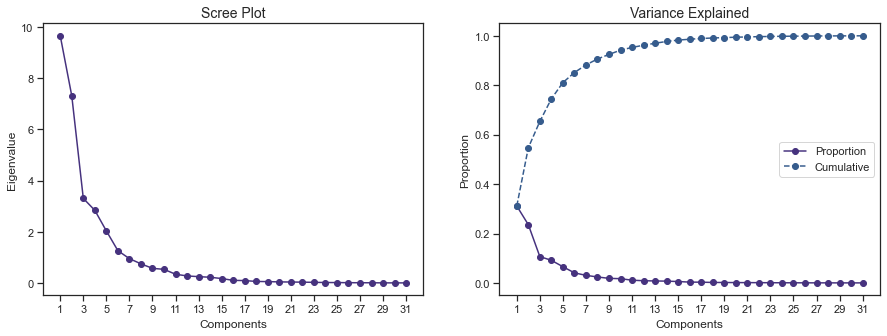

In [74]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [75]:
### Choice of the number of components 

# Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=6)
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=df_pca.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df

,PC0,PC1,PC2,PC3,PC4,PC5
0,-1.542107,-1.267757,-2.269254,0.755801,-0.342985,1.085190
1,13.228334,0.967417,-0.179709,0.185890,1.732548,2.411978
2,-2.146880,0.338050,0.449930,1.253137,0.102971,-0.190928
3,-0.464685,0.785926,-0.078125,-0.834460,-0.795437,1.698008
4,-1.543694,1.274634,-1.288689,0.567103,2.057627,0.565461
...,...,...,...,...,...,...
95407,2.443093,2.330013,5.077634,5.352461,-2.010449,-0.025044
95408,7.702697,2.500796,-2.858337,1.434030,-0.685515,-0.551555
95409,-1.745268,2.135333,-0.558580,-0.993420,-1.270859,0.112432
95410,5.073794,0.739032,-0.931377,0.003673,1.475222,1.854704


In [77]:
# Assigning the components to a dataframe
not_percentages_components = pca_df

In [76]:
# Reassigning df to contain pca variables
df_pca = pd.concat([df_pca, pca_df], axis=1)
df_pca.head()

,POP901,POP902,POP903,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,HHP1,...,TPE11,EC1,MHUC1,MHUC2,PC0,PC1,PC2,PC3,PC4,PC5
0,-0.397839,-0.416055,-0.423147,0.546797,0.782782,0.787336,0.581889,0.873422,1.073768,0.236249,...,-1.260231,-0.672247,-0.629375,-0.416406,-1.542107,-1.267757,-2.269254,0.755801,-0.342985,1.085190
1,0.056884,0.046306,-0.110330,-0.098988,-0.172706,-0.355715,-0.649850,-0.544376,-0.619831,2.754567,...,1.284400,2.296139,3.409981,1.954647,13.228334,0.967417,-0.179709,0.185890,1.732548,2.411978
2,0.645471,0.798668,0.674529,0.030169,0.100291,0.072929,0.119987,-0.012702,0.132880,-0.081186,...,0.012084,-0.672247,0.236202,-0.416406,-2.146880,0.338050,0.449930,1.253137,0.102971,-0.190928
3,-0.458955,-0.487187,-0.476222,-0.357302,-0.309204,-0.212834,-0.341915,-0.367151,-0.243476,0.257411,...,-1.419270,-0.672247,2.255880,-0.416406,-0.464685,0.785926,-0.078125,-0.834460,-0.795437,1.698008
4,-0.132541,-0.167775,-0.221648,-0.228145,0.373287,0.644454,-0.033980,0.164523,0.321057,1.019256,...,0.489203,-0.672247,-0.629375,-0.416406,-1.543694,1.274634,-1.288689,0.567103,2.057627,0.565461


In [35]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df_pca[metric_features + pca_feat_names].corr().loc[metric_features, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2,PC3,PC4,PC5
POP901,0.001252,0.134394,0.606008,0.774833,-0.042295,0.037338
POP902,0.007705,0.110924,0.572715,0.803227,-0.039268,0.012593
POP903,-0.011515,0.066999,0.636280,0.754735,-0.062079,0.002891
AGE901,0.025344,-0.923547,-0.099752,0.117396,0.228509,0.021183
AGE902,-0.090704,-0.873105,-0.251547,0.231067,0.276948,0.087372
AGE903,-0.194720,-0.870448,-0.205285,0.202593,0.237252,0.148153
AGE904,-0.120685,-0.956121,-0.019701,0.069035,0.186361,0.031910
AGE905,-0.165279,-0.894993,-0.203021,0.204240,0.236716,0.082763
AGE906,-0.245713,-0.875525,-0.164141,0.185384,0.203192,0.149035
HHP1,0.333849,0.699922,-0.391356,0.244741,0.299877,0.249550


# Computing PCA for all the 'percentages' variables of Neighborhood

In [38]:
percentages = df.drop(columns=['POP901','POP902','POP903','AGE901','AGE902','AGE903','AGE904','AGE905','AGE906','HHP1','HHP2','DW9','HV1','HV2','HV3','HV4','HUR1','RHP1','RHP2','RHP3','RHP4','MSA','ADI','DMA','IC1','IC2','IC3','IC4','IC5','TPE10','TPE11','EC1','MHUC1','MHUC2'])

In [39]:
percentages.head()

,POP90C1,POP90C2,POP90C3,POP90C4,POP90C5,ETH1,ETH2,ETH3,ETH4,ETH5,...,HC14,HC15,HC16,HC17,HC18,HC19,HC20,HC21,AC1,AC2
0,0,35,65,47,53,92,1,0,0,11,...,0,0,0,33,65,40,99,99,10,7
1,99,0,0,50,50,67,0,0,31,6,...,0,0,0,99,0,99,99,99,6,5
2,0,2,98,49,51,96,2,0,0,2,...,44,0,15,22,77,17,97,92,6,5
3,0,8,92,54,46,61,0,0,11,32,...,0,0,16,23,77,22,93,89,6,6
4,99,0,0,46,54,2,98,0,0,1,...,3,0,0,99,1,21,99,96,7,11


I do not normalize, because the variables are all percentages, thus not necessary

# PCA

In [50]:
metric_features = list(percentages.columns)

In [51]:
# Creating a copy of the dataset to compute the principal component analysis
df_pca = percentages.copy()

In [52]:
# Use PCA to reduce dimensionality of data

# Calculating the components

pca = PCA()
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat 

array([[-1.17903524e+02, -2.98706580e+01, -6.06272774e+01, ...,
         2.67712199e-03, -2.74925023e-03,  9.71268067e-04],
       [ 1.63547841e+02, -1.51581210e+02, -4.73026674e+01, ...,
        -2.37463239e-03,  5.20382632e-03, -5.52542265e-04],
       [-1.68217360e+02, -4.22874239e+01,  3.98875828e+01, ...,
         1.26635553e-02,  1.76976746e-03, -1.73092494e-04],
       ...,
       [-2.08736991e+01,  9.72607732e+01, -1.30918104e+02, ...,
         4.14621462e-03, -9.08391757e-04, -3.02485636e-03],
       [ 1.40866642e+02, -9.87270260e+01, -7.94500724e+01, ...,
        -9.14498936e-03,  5.18661058e-03, -1.90656586e-03],
       [ 5.78533385e+01, -1.08511580e+02,  2.52005874e+01, ...,
         6.84783414e-03,  3.06341937e-03, -4.52338560e-03]])

In [53]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,10797.404284,0.000000,2.369900e-01,0.236990
2,7218.527730,-3578.876554,1.584380e-01,0.395428
3,4507.921709,-2710.606022,9.894346e-02,0.494371
4,2905.492157,-1602.429552,6.377206e-02,0.558144
5,2351.882784,-553.609373,5.162100e-02,0.609765
...,...,...,...,...
248,0.033932,-0.002622,7.447606e-07,0.999999
249,0.029319,-0.004613,6.435200e-07,1.000000
250,0.008875,-0.020444,1.947880e-07,1.000000
251,0.000438,-0.008437,9.612325e-09,1.000000


In [55]:
# Cumulative variance explained by the principal components, in order
np.cumsum(pca.explained_variance_ratio_)

array([0.23699004, 0.39542804, 0.49437149, 0.55814355, 0.60976455,
       0.64823512, 0.68371155, 0.71783381, 0.73955972, 0.75901965,
       0.77624546, 0.79090197, 0.80408136, 0.81539725, 0.8264509 ,
       0.83596987, 0.84504014, 0.85319794, 0.86036055, 0.86724698,
       0.87314958, 0.87875277, 0.88403292, 0.8889794 , 0.89369348,
       0.89799383, 0.90201552, 0.90590026, 0.90946833, 0.91279517,
       0.91591006, 0.91875678, 0.92150991, 0.92405684, 0.92654592,
       0.92891614, 0.93119081, 0.93332584, 0.93540292, 0.93740282,
       0.93930737, 0.94114958, 0.94298088, 0.94467955, 0.94628035,
       0.94785316, 0.94937092, 0.95084355, 0.95228888, 0.95367747,
       0.95498877, 0.95629724, 0.9575763 , 0.95880482, 0.95998375,
       0.96111685, 0.96217551, 0.96319511, 0.96418487, 0.96512478,
       0.96603133, 0.96689616, 0.96775392, 0.96855967, 0.96935844,
       0.97014217, 0.97091199, 0.97165173, 0.97237415, 0.9730805 ,
       0.9737692 , 0.97443269, 0.97507778, 0.97570244, 0.97631

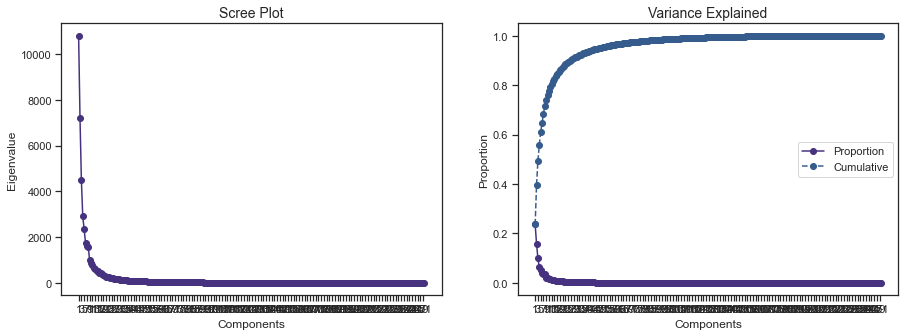

In [54]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [56]:
### Defining number of components

# Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=13)
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=df_pca.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
0,-117.903524,-29.870658,-60.627277,35.194203,15.194145,-10.541780,-66.357938,-0.647194,11.627166,4.312434,-37.985109,-8.798478,7.010523
1,163.547841,-151.581210,-47.302667,-7.657675,-58.080765,48.969986,23.762250,57.675658,21.125328,-64.854913,5.589530,-30.642589,24.804762
2,-168.217360,-42.287424,39.887583,9.100217,-48.912610,-26.029920,1.228486,-34.298195,-0.584826,-13.635389,-1.253496,2.469999,13.242680
3,-106.970291,-20.009292,8.251061,52.690647,-118.085393,-2.759190,7.714478,52.096913,-12.520054,69.473776,19.066757,-3.364174,9.670478
4,-37.401307,41.903723,-55.888479,-39.959925,-10.971515,-55.377732,103.802732,36.439153,-89.427839,-52.005946,-16.208179,100.858541,-35.759612
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95407,102.546011,-18.144402,26.325030,-72.329172,-7.057008,3.966838,-3.537416,0.313851,30.675903,30.140140,-0.660541,8.231286,-13.811596
95408,62.080826,-124.091486,-13.725592,-18.354063,20.973260,-18.387540,-56.049628,71.107237,34.631720,-37.875984,11.773448,-47.892157,-21.095628
95409,-20.873699,97.260773,-130.918104,-30.343372,17.285591,-56.642758,-28.493800,17.128483,-8.763892,3.431241,5.087199,-27.281311,-40.301949
95410,140.866642,-98.727026,-79.450072,4.873345,-48.107911,37.061465,23.049906,0.781714,16.959066,-35.148328,-8.015828,4.389193,37.134837


In [57]:
# Reassigning df to contain pca variables
df_pca = pd.concat([df_pca, pca_df], axis=1)
df_pca.head()

,POP90C1,POP90C2,POP90C3,POP90C4,POP90C5,ETH1,ETH2,ETH3,ETH4,ETH5,...,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
0,0,35,65,47,53,92,1,0,0,11,...,35.194203,15.194145,-10.541780,-66.357938,-0.647194,11.627166,4.312434,-37.985109,-8.798478,7.010523
1,99,0,0,50,50,67,0,0,31,6,...,-7.657675,-58.080765,48.969986,23.762250,57.675658,21.125328,-64.854913,5.589530,-30.642589,24.804762
2,0,2,98,49,51,96,2,0,0,2,...,9.100217,-48.912610,-26.029920,1.228486,-34.298195,-0.584826,-13.635389,-1.253496,2.469999,13.242680
3,0,8,92,54,46,61,0,0,11,32,...,52.690647,-118.085393,-2.759190,7.714478,52.096913,-12.520054,69.473776,19.066757,-3.364174,9.670478
4,99,0,0,46,54,2,98,0,0,1,...,-39.959925,-10.971515,-55.377732,103.802732,36.439153,-89.427839,-52.005946,-16.208179,100.858541,-35.759612


In [60]:
# Assigning the result of the only components into a dataframe
percentages_components = df_pca.iloc[:, -13:]

In [58]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df_pca[metric_features + pca_feat_names].corr().loc[metric_features, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
POP90C1,0.777528,0.221158,-0.164274,-0.214366,0.099846,-0.387563,0.265830,-0.000808,0.098315,-0.058691,0.058838,-0.063585,0.025805
POP90C2,-0.257672,0.146879,-0.047725,0.022113,0.226090,0.780237,-0.318864,0.078118,-0.232781,0.099361,-0.020844,0.139017,0.037655
POP90C3,-0.717119,-0.379016,0.231255,0.232236,-0.292864,-0.147868,-0.065546,-0.063485,0.066788,-0.011306,-0.053605,-0.032733,-0.059687
POP90C4,-0.059264,-0.309455,0.032384,-0.134954,-0.292567,-0.088589,-0.143920,0.083447,-0.123867,0.110144,0.043771,-0.179836,-0.018533
POP90C5,0.059263,0.309306,-0.032441,0.134936,0.292561,0.088517,0.143872,-0.083493,0.123795,-0.110124,-0.043804,0.179822,0.018552
ETH1,-0.097932,-0.341047,0.061570,0.192015,0.327656,0.094227,-0.144934,-0.582427,0.150006,0.179218,0.182278,-0.400957,0.145494
ETH2,-0.090023,0.319888,-0.052911,-0.200256,-0.130877,-0.149175,0.125257,0.423064,-0.050414,-0.299498,-0.071097,0.577636,-0.306918
ETH3,-0.114852,0.036860,0.033673,-0.010187,-0.062173,0.047462,-0.004445,0.110601,-0.000701,0.022621,-0.026632,-0.018832,-0.011833
ETH4,0.403092,-0.009418,-0.017127,0.059112,-0.271056,0.039116,0.023223,0.177879,-0.114831,-0.082179,-0.045212,0.014383,0.080454
ETH5,0.207280,0.163266,-0.015765,-0.121295,-0.291157,0.024641,0.120453,0.400935,-0.242430,0.301433,-0.294666,-0.347100,0.325719


# Final result of the input space reduction using PCA for the Neighborhood variables

I have splitted the 286 variables in percentages variables and not percentages variables.
- 34 variables not_percentages
- 252 variables percentages

For the not_percentages variables, I have not considered the non_metric_feature.
Variables that explain a type of code, so categorical, not really numerical.
- MSA
- ADI
- DMA
I have normalized the metric feature for the not_percentages variables with StandardScaler()

In [80]:
not_percentages_components.columns

Index(['PC0', 'PC1', 'PC2', 'PC3', 'PC4', 'PC5'], dtype='object')

In [ ]:
df.columns = ['a', 'b']

In [81]:
not_percentages_components.columns = ['PC1 NP','PC2 NP','PC3 NP','PC4 NP','PC5 NP','PC6 NP']

In [84]:
percentages_components.columns = ['PC1 P','PC2 P','PC3 P','PC4 P','PC5 P','PC6 P','PC7 P','PC8 P','PC9 P','PC10 P','PC11 P','PC12 P','PC13 P',]

In [88]:
PC_Neighborhood = pd.concat([not_percentages_components, percentages_components], axis=1)

In [90]:
PC_Neighborhood

,PC1 NP,PC2 NP,PC3 NP,PC4 NP,PC5 NP,PC6 NP,PC1 P,PC2 P,PC3 P,PC4 P,PC5 P,PC6 P,PC7 P,PC8 P,PC9 P,PC10 P,PC11 P,PC12 P,PC13 P
0,-1.542107,-1.267757,-2.269254,0.755801,-0.342985,1.085190,-117.903524,-29.870658,-60.627277,35.194203,15.194145,-10.541780,-66.357938,-0.647194,11.627166,4.312434,-37.985109,-8.798478,7.010523
1,13.228334,0.967417,-0.179709,0.185890,1.732548,2.411978,163.547841,-151.581210,-47.302667,-7.657675,-58.080765,48.969986,23.762250,57.675658,21.125328,-64.854913,5.589530,-30.642589,24.804762
2,-2.146880,0.338050,0.449930,1.253137,0.102971,-0.190928,-168.217360,-42.287424,39.887583,9.100217,-48.912610,-26.029920,1.228486,-34.298195,-0.584826,-13.635389,-1.253496,2.469999,13.242680
3,-0.464685,0.785926,-0.078125,-0.834460,-0.795437,1.698008,-106.970291,-20.009292,8.251061,52.690647,-118.085393,-2.759190,7.714478,52.096913,-12.520054,69.473776,19.066757,-3.364174,9.670478
4,-1.543694,1.274634,-1.288689,0.567103,2.057627,0.565461,-37.401307,41.903723,-55.888479,-39.959925,-10.971515,-55.377732,103.802732,36.439153,-89.427839,-52.005946,-16.208179,100.858541,-35.759612
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95407,2.443093,2.330013,5.077634,5.352461,-2.010449,-0.025044,102.546011,-18.144402,26.325030,-72.329172,-7.057008,3.966838,-3.537416,0.313851,30.675903,30.140140,-0.660541,8.231286,-13.811596
95408,7.702697,2.500796,-2.858337,1.434030,-0.685515,-0.551555,62.080826,-124.091486,-13.725592,-18.354063,20.973260,-18.387540,-56.049628,71.107237,34.631720,-37.875984,11.773448,-47.892157,-21.095628
95409,-1.745268,2.135333,-0.558580,-0.993420,-1.270859,0.112432,-20.873699,97.260773,-130.918104,-30.343372,17.285591,-56.642758,-28.493800,17.128483,-8.763892,3.431241,5.087199,-27.281311,-40.301949
95410,5.073794,0.739032,-0.931377,0.003673,1.475222,1.854704,140.866642,-98.727026,-79.450072,4.873345,-48.107911,37.061465,23.049906,0.781714,16.959066,-35.148328,-8.015828,4.389193,37.134837


Max percentage 
 PC1 NP     18.034686
PC2 NP     19.540701
PC3 NP     16.646156
PC4 NP     21.802781
PC5 NP     16.133995
PC6 NP     12.684940
PC1 P     240.153891
PC2 P     348.835112
PC3 P     250.427258
PC4 P     244.518392
PC5 P     208.258036
PC6 P     162.487409
PC7 P     192.994265
PC8 P     217.366909
PC9 P     172.386016
PC10 P    129.108836
PC11 P    149.940276
PC12 P    134.753976
PC13 P    127.477736
dtype: float64
--------------------------------------------------------------
Median percentage 
 PC1 NP   -0.710236
PC2 NP    0.329188
PC3 NP   -0.441482
PC4 NP   -0.038613
PC5 NP   -0.109495
PC6 NP   -0.000488
PC1 P     3.300100
PC2 P    -6.971139
PC3 P     0.251760
PC4 P    -1.419723
PC5 P    -1.739920
PC6 P    -6.487244
PC7 P     1.447488
PC8 P    -4.264747
PC9 P     1.733929
PC10 P   -1.571888
PC11 P   -1.440649
PC12 P   -1.337250
PC13 P    0.898578
dtype: float64
--------------------------------------------------------------
Min percentage 
 PC1 NP    -10.341351
PC2 NP   

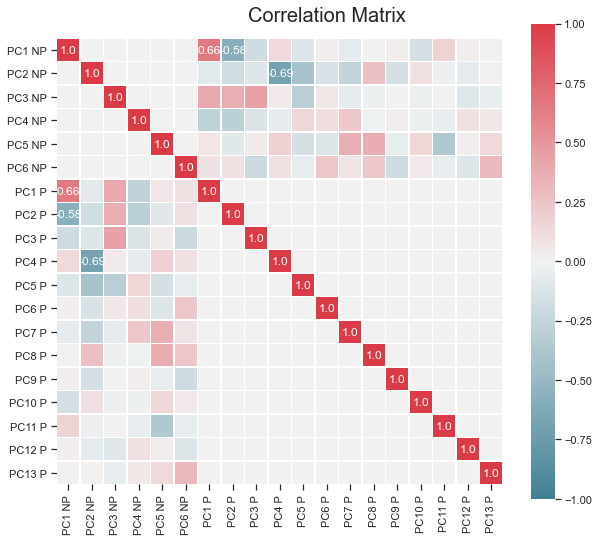

(None, None)

In [97]:
overview(PC_Neighborhood)